# <center>Análisis Complejidad Electoral 2019: Municipios <center>
## <center>Análisis de Agrupamiento y Construcción Tipología de Complejidad Electoral <center>

<br>

#### <center>INFOTEC-Maestría en Ciencia de Datos e Información <center>
#### <center>Autor: Miguel David Alvarez Hernández (mdalvarezh@gmail.com)<center>

In [1]:
import datetime
now = datetime.datetime.now()
print ("Última versión:")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

Última versión:
2020-07-27 15:25:56


# Setup

In [2]:
import pandas as pd  
import numpy as np
import pandas_profiling
from itertools import combinations 
from dateutil.parser import parse 
import matplotlib as mpl
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import plotly.express as px

# Importación de datos procesados

In [3]:
#datos procesados
datos = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/1_Procesamiento/Resultados_Datos-procesados_mun2019.csv", encoding='utf-8')

In [4]:
print(datos.dtypes)
datos

EDO                   int64
NOMBRE_ESTADO        object
MUN                   int64
NOMBRE_MUNICIPIO     object
Coef_Var_PE         float64
Coef_Var_LNE        float64
Var_Prop_PE         float64
Var_Prop_LNE        float64
Autocorr_PE         float64
Autocorr_LNE        float64
Razon_LNE_PE        float64
PE                  float64
LNE                 float64
TC_LNE_2019         float64
NUM_SECC_RUR          int64
Area_Km2            float64
Densidad_LNE        float64
dtype: object


,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,Coef_Var_PE,Coef_Var_LNE,Var_Prop_PE,Var_Prop_LNE,Autocorr_PE,Autocorr_LNE,Razon_LNE_PE,PE,LNE,TC_LNE_2019,NUM_SECC_RUR,Area_Km2,Densidad_LNE
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,0.017131,0.015085,0.020041,0.017733,0.965775,0.755939,0.989272,35518.0,34917.0,0.037498,3,9.791576,3566.024547
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,0.005040,0.008345,0.005584,0.008887,0.435676,0.237061,0.991803,7004.0,6914.0,0.000289,4,3.241104,2133.223463
2,1,AGUASCALIENTES,9,TEPEZALA,0.006879,0.011777,0.007903,0.011921,0.605737,0.344567,0.990635,15733.0,15545.0,0.005108,6,6.271495,2478.675412
3,1,AGUASCALIENTES,11,EL LLANO,0.008917,0.012239,0.009983,0.014232,0.585621,0.504020,0.991016,15298.0,15067.0,-0.003373,6,10.006312,1505.749552
4,1,AGUASCALIENTES,2,ASIENTOS,0.008083,0.013432,0.009252,0.015397,0.581193,0.374738,0.989080,34722.0,34222.0,0.001874,11,23.049424,1484.722551
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2451,32,ZACATECAS,45,TEPECHITLAN,0.014994,0.019408,0.017748,0.021905,0.987834,0.959378,0.983523,7061.0,6959.0,0.066677,13,13.507234,515.205401
2452,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,0.019415,0.022769,0.022931,0.026072,0.964977,0.984897,0.986450,17610.0,17372.0,0.082705,32,17.129462,1014.159112
2453,32,ZACATECAS,44,TABASCO,0.027363,0.029823,0.032716,0.035416,0.992677,0.993335,0.983221,12689.0,12527.0,0.100307,16,8.620183,1453.217492
2454,32,ZACATECAS,9,CHALCHIHUITES,0.016451,0.021097,0.019649,0.024771,0.975279,0.988608,0.982861,8339.0,8222.0,0.075052,10,13.707054,599.837116


In [5]:
#se reordena y eliminan del dataframe las variables que no se usarán
datos_mun = datos.drop(columns=['Coef_Var_PE', 'Var_Prop_PE', 'Autocorr_PE','Area_Km2'])
datos_mun = datos_mun.reindex(columns= ['EDO','NOMBRE_ESTADO','MUN','NOMBRE_MUNICIPIO','NUM_SECC_RUR','LNE','Densidad_LNE','Razon_LNE_PE','TC_LNE_2019','Coef_Var_LNE','Var_Prop_LNE','Autocorr_LNE'])

#verificar si hay valores nulos en datos_mun
datos_mun.isnull().sum()

EDO                 0
NOMBRE_ESTADO       0
MUN                 0
NOMBRE_MUNICIPIO    0
NUM_SECC_RUR        0
LNE                 0
Densidad_LNE        0
Razon_LNE_PE        0
TC_LNE_2019         0
Coef_Var_LNE        0
Var_Prop_LNE        0
Autocorr_LNE        0
dtype: int64

In [6]:
#se eliminan las filas (municipios) con valores vacíos
datos_mun_limpio = datos_mun.dropna()
datos_mun_limpio = datos_mun_limpio.reset_index(drop=True) #para reordenar el índice del nuevo dataframe
datos_mun_limpio.isnull().sum()

EDO                 0
NOMBRE_ESTADO       0
MUN                 0
NOMBRE_MUNICIPIO    0
NUM_SECC_RUR        0
LNE                 0
Densidad_LNE        0
Razon_LNE_PE        0
TC_LNE_2019         0
Coef_Var_LNE        0
Var_Prop_LNE        0
Autocorr_LNE        0
dtype: int64

In [7]:
#se transforman algunos indicadores para analizar escenarios
datos_mun_limpio_tf = datos_mun_limpio.copy()

#np-log de LNE, Densidad
datos_mun_limpio_tf['LNE'] = np.log(datos_mun_limpio_tf['LNE'])
datos_mun_limpio_tf['Densidad_LNE'] = np.log(datos_mun_limpio_tf['Densidad_LNE'])
#datos_mun_limpio_tf['NUM_SECC_RUR'] = np.log(datos_mun_limpio_tf['NUM_SECC_RUR']+1)

In [8]:
#se separan los indicadores de los metadatos 

#metadatos
metadatos = datos_mun_limpio[['EDO', 'NOMBRE_ESTADO', 'MUN', 'NOMBRE_MUNICIPIO']]

#indicadores (features)
datos_mun_limpio_f = datos_mun_limpio[['NUM_SECC_RUR','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE','Autocorr_LNE']]

#indicadores con transformación log (features)
datos_mun_limpio_f_tf = datos_mun_limpio_tf[['NUM_SECC_RUR','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE','Autocorr_LNE']]

# Resultados de los escenarios PCA

In [9]:
#escenario con 7 indicadores (sin Coef_Var_Prop)
df_pca_results_ind7 = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/2_Exploratorio-PCA/Resultados_Mun_PCA_ind7.csv", dtype={'EDO':int,'MUN':int})

#formamos un np-array con las columnas_pca para la sección de métodos de agrupamiento
columnas_7pca = ['CP1', 'CP2', 'CP3','CP4', 'CP5', 'CP6','CP7']
x_pca = df_pca_results_ind7.loc[:, columnas_7pca].values

print(x_pca.shape)

(2456, 7)


In [10]:
#escenario con 8 indicadores 
df_pca_results_ind8 = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/2_Exploratorio-PCA/Resultados_Mun_PCA_ind8.csv", dtype={'EDO':int,'MUN':int})

#formamos un np-array con las columnas_pca para la sección de métodos de agrupamiento
columnas_8pca =  ['CP1', 'CP2', 'CP3','CP4', 'CP5', 'CP6','CP7', 'CP8']
x2_pca = df_pca_results_ind8.loc[:, columnas_8pca].values

print(x2_pca.shape)

(2456, 8)


In [11]:
#escenario con 8 indicadores con transformación log (solo en LNE y Densidad)
df_pca_results_ind8_tf = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/2_Exploratorio-PCA/Resultados_Mun_PCA_ind8_tf.csv", dtype={'EDO':int,'MUN':int})

#formamos un np-array con las columnas_pca para la sección de métodos de agrupamiento
columnas_8pca =  ['CP1', 'CP2', 'CP3','CP4', 'CP5', 'CP6','CP7', 'CP8']
x3_pca = df_pca_results_ind8_tf.loc[:, columnas_8pca].values

print(x3_pca.shape)

(2456, 8)


<br>

# Agrupamiento y construcción de la Tipología de Complejidad

## Análisis de silueta y configuración óptima de grupos (7 indicadores)
Cálculo de los silhouette_scores para diferentes números de clusters en Kmeans

For n_clusters = 2 The average silhouette_score is : 0.3268052665968438
For n_clusters = 3 The average silhouette_score is : 0.25194869674913944
For n_clusters = 4 The average silhouette_score is : 0.26860835974482883
For n_clusters = 5 The average silhouette_score is : 0.30150571942847915
For n_clusters = 6 The average silhouette_score is : 0.3017976021438838
For n_clusters = 7 The average silhouette_score is : 0.25647408777852354


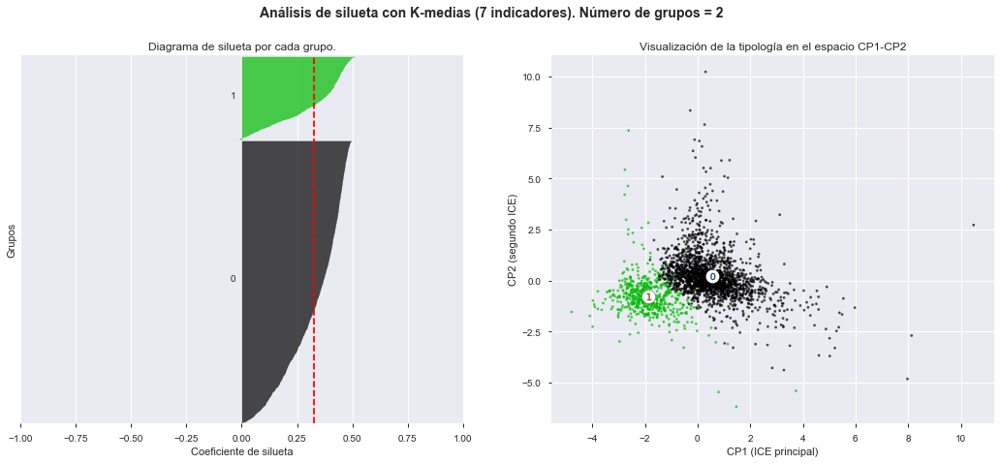

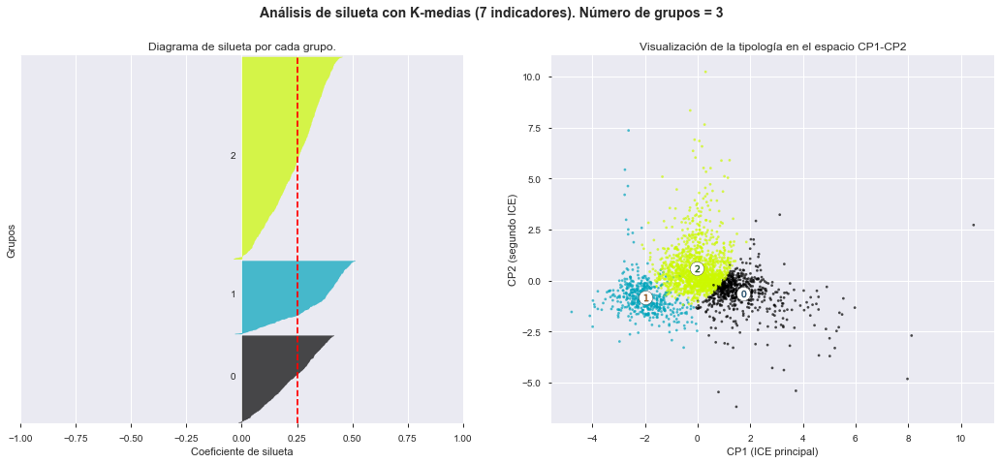

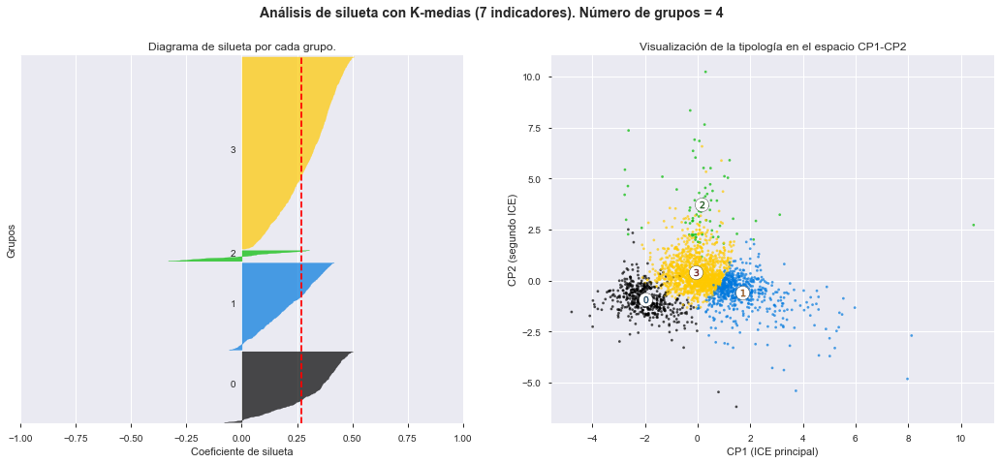

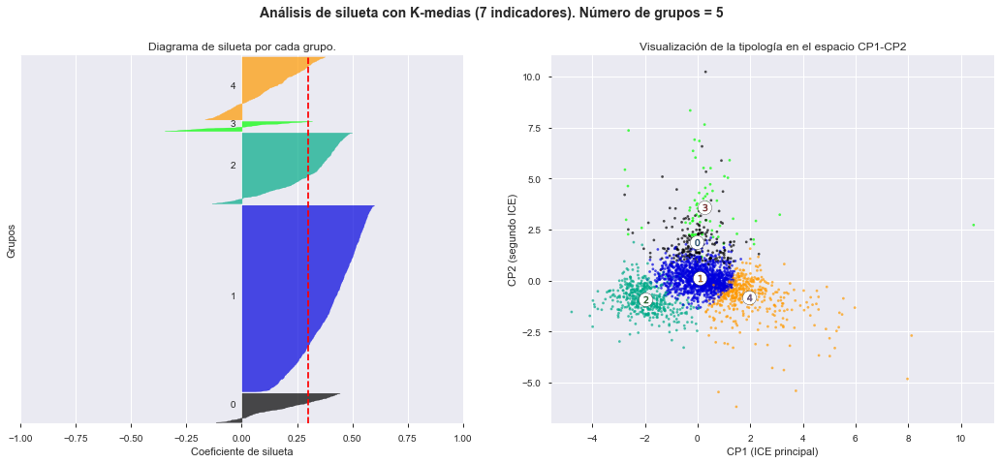

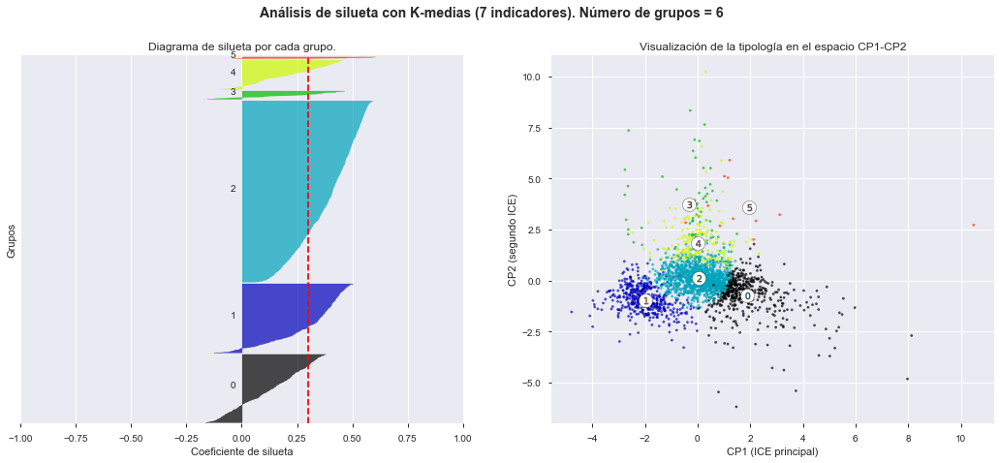

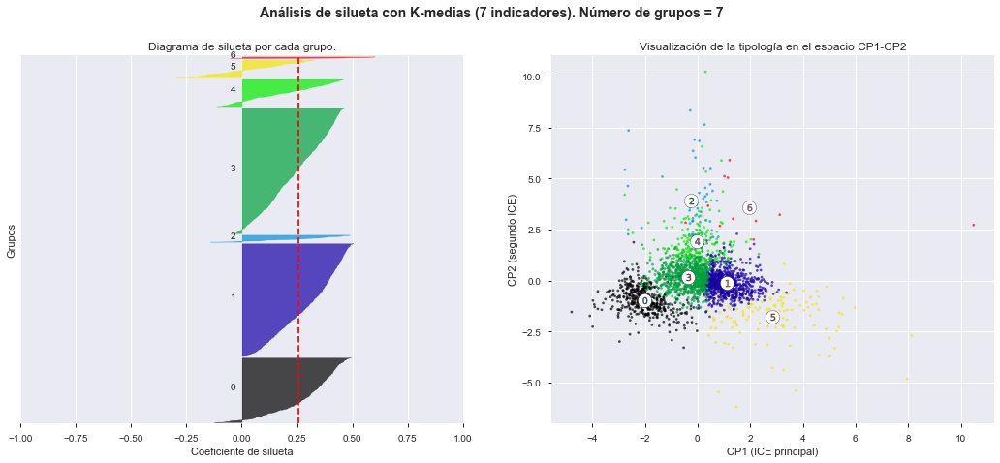

In [12]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

#Datos en el espacio de las componentes principales
X=x_pca

#numero de clusters/grupos que serán analizados
range_n_clusters = [2, 3, 4, 5,6,7]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 0 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Diagrama de silueta por cada grupo.")
    ax1.set_xlabel("Coeficiente de silueta")
    ax1.set_ylabel("Grupos")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("Visualización de la tipología en el espacio CP1-CP2")
    ax2.set_xlabel("CP1 (ICE principal)")
    ax2.set_ylabel("CP2 (segundo ICE)")

    plt.suptitle(("Análisis de silueta con K-medias (7 indicadores). "
                  "Número de grupos = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    plt.savefig('Pyplot_silhouette_score_ind7_Kmeans_'+str(n_clusters)+'.png',dpi=600)

In [13]:
#se obtienen las etiquetas predichas por K-medias para la configuración con el mayor
#valor promedio del silhouete score (n=3)
num_clusters_ind7 = 3
clusterer_K = KMeans(n_clusters=num_clusters_ind7, random_state=0)
clusterer_K_labels = clusterer_K.fit_predict(X)

#se obtienen las etiquetas predichas por Kmeans
y_pred_kmeans = clusterer_K_labels
#se guarda el nparray en un dataframe
y_pred_kmeans = pd.DataFrame(y_pred_kmeans, columns=['TCE_municipal'])

#se transforman las etiquetas numéricas a str
etiquetas_grupos = {0:'G0', 1:'G1', 2:'G2'}
y_pred_kmeans['TCE_municipal']=y_pred_kmeans['TCE_municipal'].apply(lambda x: etiquetas_grupos[x])

#concatenamos los resultados de PCA con las etiquetas de Kmeans
df_pca_results_ind7_kmeans = pd.concat([df_pca_results_ind7, y_pred_kmeans], axis = 1)

#se guardan los resultados en un csv
df_pca_results_ind7_kmeans.to_csv(r'Resultados_Mun_PCA_Kmeans_ind7.csv', index = None)

df_pca_results_ind7_kmeans

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-0.977398,0.028042,0.063097,-0.606314,-0.008890,0.125724,-0.186441,G2
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.305609,-0.809967,0.532808,-0.047750,-0.023314,0.850008,-1.029154,G1
2,1,AGUASCALIENTES,9,TEPEZALA,-2.703711,-0.620490,0.542320,0.068364,-0.057031,0.809700,-0.703313,G1
3,1,AGUASCALIENTES,11,EL LLANO,-2.515591,-0.453120,0.098471,0.009010,0.012804,0.548283,-0.124460,G1
4,1,AGUASCALIENTES,2,ASIENTOS,-2.526716,-0.502715,0.527982,0.636861,0.018323,0.718382,-0.491248,G1
...,...,...,...,...,...,...,...,...,...,...,...,...
2451,32,ZACATECAS,45,TEPECHITLAN,0.474839,-0.023246,-0.549936,0.546248,-0.199900,-0.472914,-0.071207,G2
2452,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,0.839216,1.142958,-0.860098,1.574717,-0.746442,0.231823,-0.248003,G2
2453,32,ZACATECAS,44,TABASCO,1.811809,0.107685,-0.395599,0.746232,-0.167810,0.308384,-0.195661,G0
2454,32,ZACATECAS,9,CHALCHIHUITES,0.826509,-0.159580,-0.518258,0.361126,-0.074305,-0.489058,-0.079668,G2


<br>

## Análisis de silueta y configuración óptima de grupos (8 indicadores)
Cálculo de los silhouette_scores para diferentes números de clusters en Kmeans

For n_clusters = 2 The average silhouette_score is : 0.23917053050715864
For n_clusters = 3 The average silhouette_score is : 0.2584744413243779
For n_clusters = 4 The average silhouette_score is : 0.2755949465540704
For n_clusters = 5 The average silhouette_score is : 0.2589398155999597
For n_clusters = 6 The average silhouette_score is : 0.2668455704720142
For n_clusters = 7 The average silhouette_score is : 0.2746684755952262


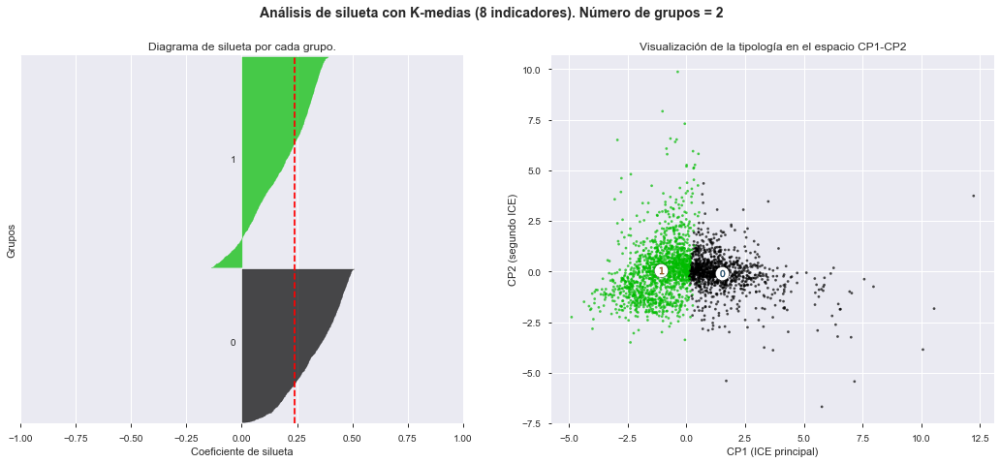

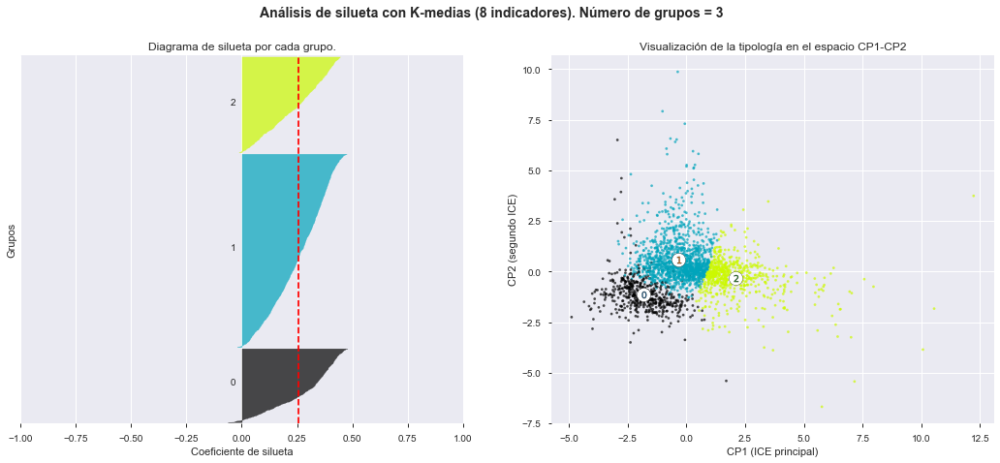

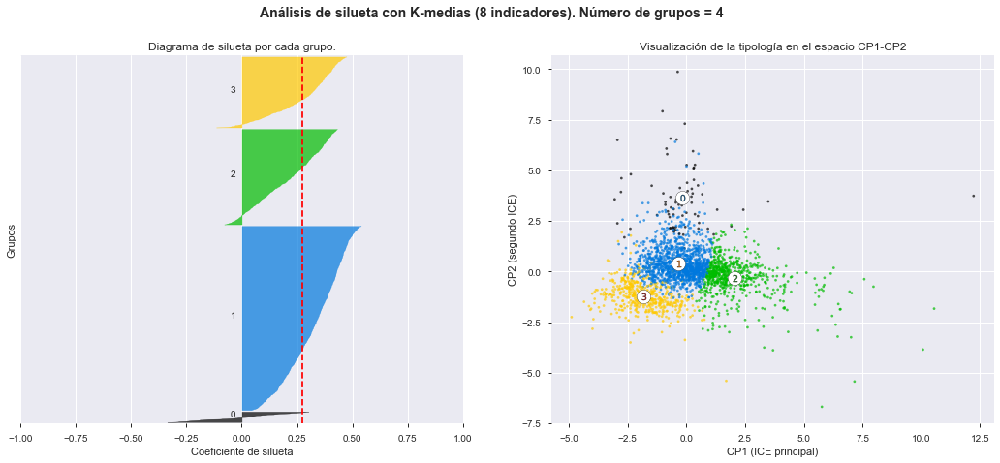

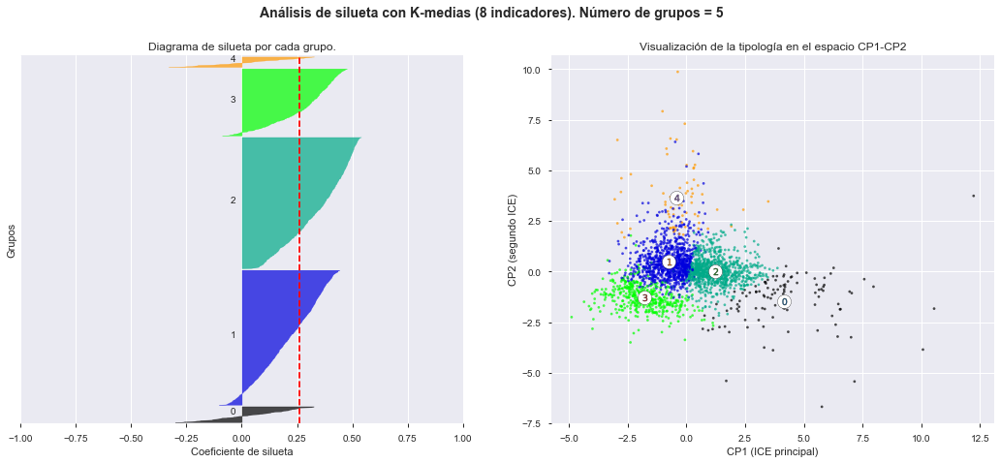

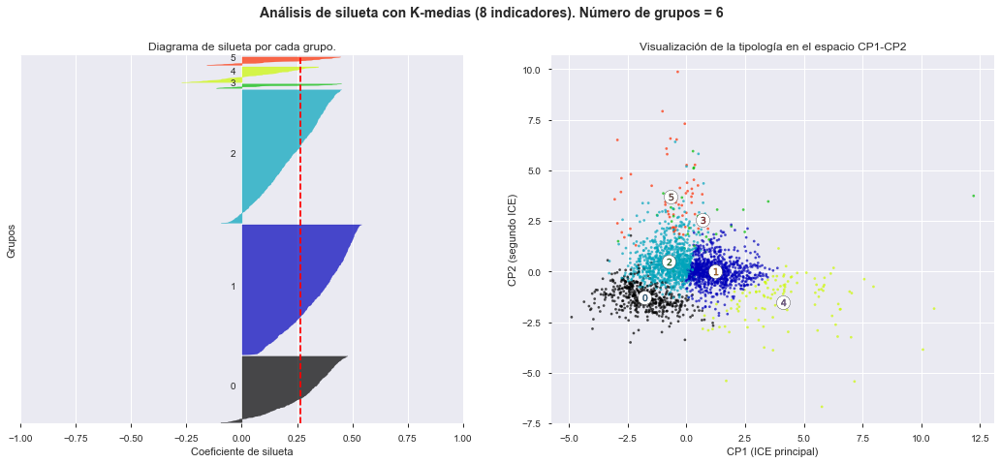

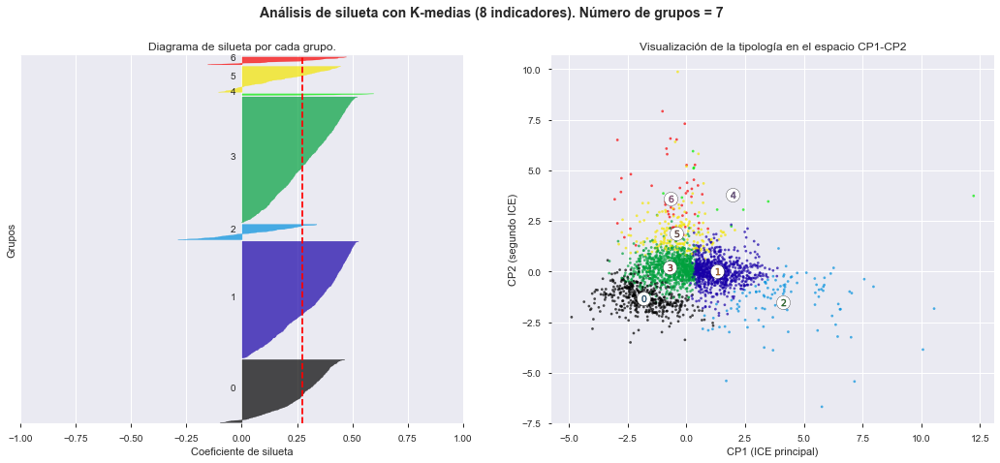

In [14]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

#Datos en el espacio de las componentes principales
X=x2_pca

#numero de clusters/grupos que serán analizados
range_n_clusters = [2, 3, 4, 5, 6, 7]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 0 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Diagrama de silueta por cada grupo.")
    ax1.set_xlabel("Coeficiente de silueta")
    ax1.set_ylabel("Grupos")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("Visualización de la tipología en el espacio CP1-CP2")
    ax2.set_xlabel("CP1 (ICE principal)")
    ax2.set_ylabel("CP2 (segundo ICE)")

    plt.suptitle(("Análisis de silueta con K-medias (8 indicadores). "
                  "Número de grupos = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    plt.savefig('Pyplot_silhouette_score_ind8_Kmeans_'+str(n_clusters)+'.png',dpi=600)

In [15]:
#se obtienen las etiquetas predichas por K-medias para la configuración con el mayor
#valor promedio del silhouete score (n=4)
num_clusters_ind8 = 4
clusterer_K = KMeans(n_clusters=num_clusters_ind8, random_state=0)
clusterer_K_labels = clusterer_K.fit_predict(X)

#se obtienen las etiquetas predichas por Kmeans
y_pred_kmeans = clusterer_K_labels
#se guarda el nparray en un dataframe
y_pred_kmeans = pd.DataFrame(y_pred_kmeans, columns=['TCE_municipal'])

#se transforman las etiquetas numéricas a str (adecuacion para preservar color de anteriores graficas)
etiquetas_grupos = {0:'G0', 1:'G1', 2:'G2', 3:'G3'}
y_pred_kmeans['TCE_municipal']=y_pred_kmeans['TCE_municipal'].apply(lambda x: etiquetas_grupos[x])

#concatenamos los resultados de PCA con las etiquetas de Kmeans
df_pca_results_ind8_kmeans = pd.concat([df_pca_results_ind8, y_pred_kmeans], axis = 1)

#se guardan los resultados en un csv
df_pca_results_ind8_kmeans.to_csv(r'Resultados_Mun_PCA_Kmeans_ind8.csv', index = None)

df_pca_results_ind8_kmeans

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-1.159709,-0.088926,0.085300,-0.543018,-0.142316,-0.222009,-0.187705,-0.002198,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.440113,-1.285088,0.728496,0.120293,-0.172909,-0.843930,-1.123407,0.030126,G3
2,1,AGUASCALIENTES,9,TEPEZALA,-2.781418,-1.021450,0.718691,0.206965,-0.102529,-0.798143,-0.809299,0.100433,G3
3,1,AGUASCALIENTES,11,EL LLANO,-2.534965,-0.830443,0.289642,0.205096,-0.207061,-0.719092,-0.162937,-0.020207,G3
4,1,AGUASCALIENTES,2,ASIENTOS,-2.431221,-0.916419,0.761197,0.793724,-0.097414,-0.731473,-0.563508,-0.024154,G3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2451,32,ZACATECAS,45,TEPECHITLAN,0.252723,0.103555,-0.618837,0.425519,0.394889,0.573138,-0.033045,0.063151,G1
2452,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,0.720756,1.253073,-0.777851,1.510855,0.934339,-0.176500,-0.291345,0.040071,G1
2453,32,ZACATECAS,44,TABASCO,2.179487,0.318697,-0.418799,0.704955,0.279212,-0.166946,-0.244594,-0.062764,G2
2454,32,ZACATECAS,9,CHALCHIHUITES,0.719159,0.007821,-0.612772,0.247552,0.252320,0.595254,-0.030123,-0.003973,G1


<br>

## Análisis de silueta y configuración óptima de grupos (8 indicadores con transformación log)
Cálculo de los silhouette_scores para diferentes números de clusters en Kmeans

For n_clusters = 2 The average silhouette_score is : 0.22889281562769426
For n_clusters = 3 The average silhouette_score is : 0.21925903232866342
For n_clusters = 4 The average silhouette_score is : 0.21510690160761817
For n_clusters = 5 The average silhouette_score is : 0.19957577183308023
For n_clusters = 6 The average silhouette_score is : 0.20870410974430378
For n_clusters = 7 The average silhouette_score is : 0.19375164136659656


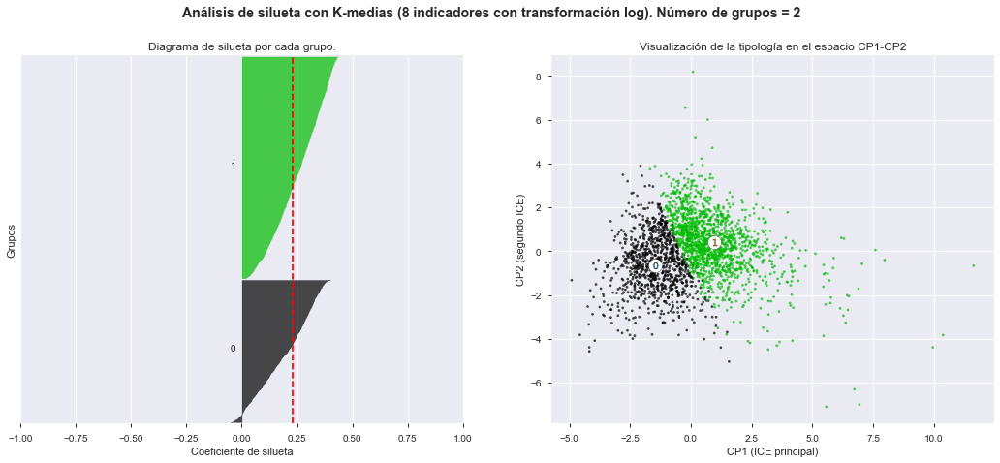

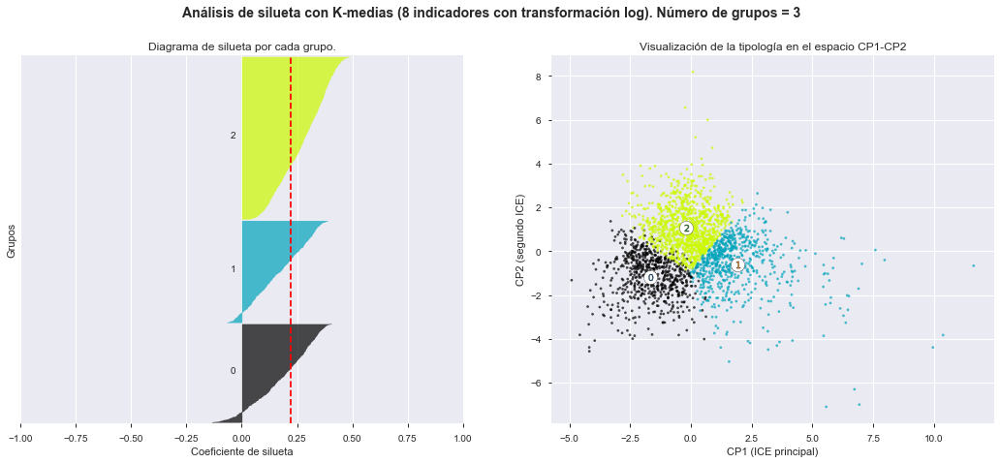

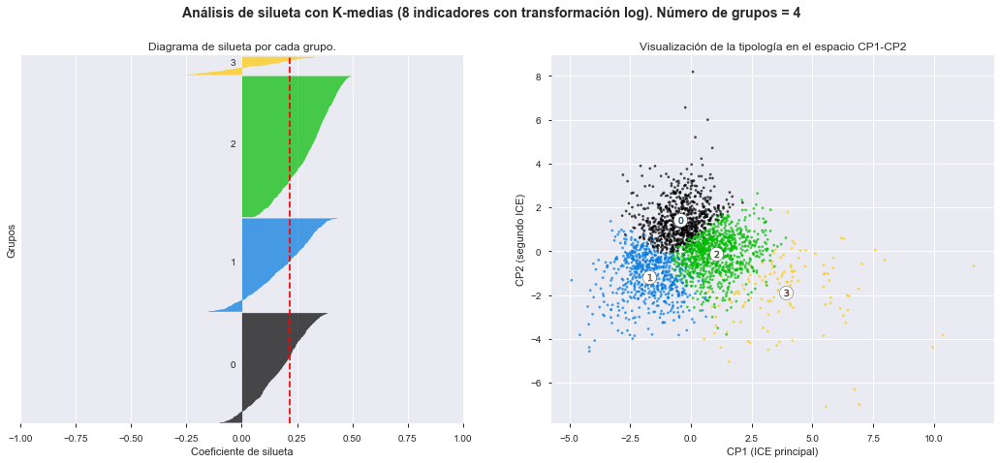

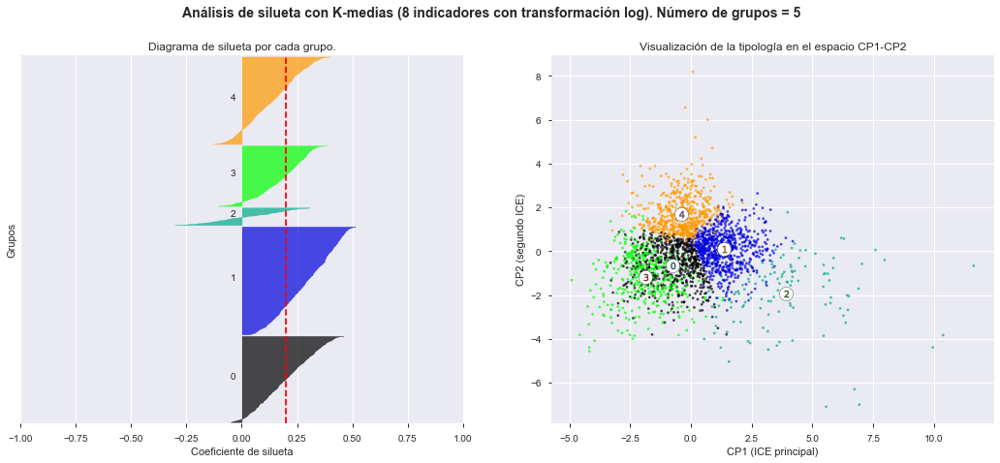

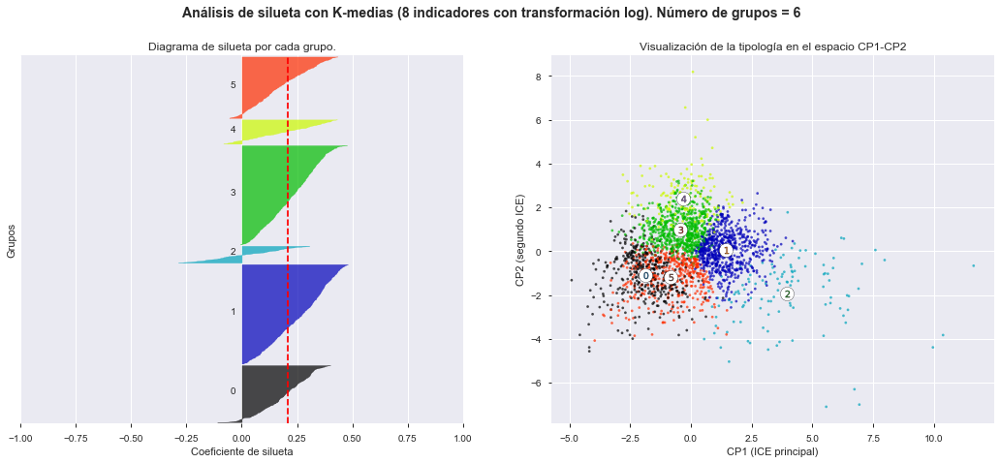

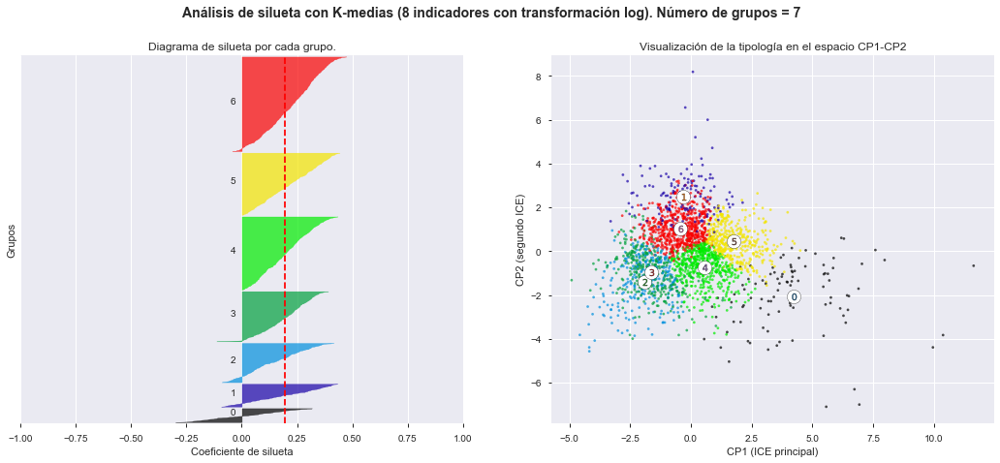

In [16]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

#Datos en el espacio de las componentes principales
X=x3_pca

#numero de clusters/grupos que serán analizados
range_n_clusters = [2, 3, 4, 5, 6, 7]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 0 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Diagrama de silueta por cada grupo.")
    ax1.set_xlabel("Coeficiente de silueta")
    ax1.set_ylabel("Grupos")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("Visualización de la tipología en el espacio CP1-CP2")
    ax2.set_xlabel("CP1 (ICE principal)")
    ax2.set_ylabel("CP2 (segundo ICE)")

    plt.suptitle(("Análisis de silueta con K-medias (8 indicadores con transformación log). "
                  "Número de grupos = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    plt.savefig('Pyplot_silhouette_score_ind8_tf_Kmeans_'+str(n_clusters)+'.png',dpi=600)

In [17]:
#se obtienen las etiquetas predichas por K-medias para la configuración con el mayor
#valor promedio del silhouete score (n=3)
num_clusters_ind8_tf = 4
clusterer_K = KMeans(n_clusters=num_clusters_ind8_tf, random_state=0)
clusterer_K_labels = clusterer_K.fit_predict(X)

#se obtienen las etiquetas predichas por Kmeans
y_pred_kmeans = clusterer_K_labels
#se guarda el nparray en un dataframe
y_pred_kmeans = pd.DataFrame(y_pred_kmeans, columns=['TCE_municipal'])

#se transforman las etiquetas numéricas a str (adecuacion para preservar color de anteriores graficas)
etiquetas_grupos = {0:'G0', 1:'G1', 2:'G2', 3:'G3'}
y_pred_kmeans['TCE_municipal']=y_pred_kmeans['TCE_municipal'].apply(lambda x: etiquetas_grupos[x])

#concatenamos los resultados de PCA con las etiquetas de Kmeans
df_pca_results_ind8_tf_kmeans = pd.concat([df_pca_results_ind8_tf, y_pred_kmeans], axis = 1)

#se guardan los resultados en un csv
df_pca_results_ind8_tf_kmeans.to_csv(r'Resultados_Mun_PCA_Kmeans_ind8_tf.csv', index = None)

df_pca_results_ind8_tf_kmeans

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-1.123957,0.770085,0.164774,-0.915654,-0.492972,-0.317918,-0.188139,0.012307,G0
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.456425,-0.735941,1.007405,-0.562512,-0.936801,0.185125,-1.159336,0.032465,G1
2,1,AGUASCALIENTES,9,TEPEZALA,-2.780315,-0.217879,1.125977,-0.520060,-0.949179,-0.029845,-0.828418,0.109442,G1
3,1,AGUASCALIENTES,11,EL LLANO,-2.545177,-0.264797,0.625283,-0.108215,-0.902348,-0.148185,-0.154942,-0.011660,G1
4,1,AGUASCALIENTES,2,ASIENTOS,-2.432097,-0.075186,1.405509,0.187352,-0.990950,-0.483391,-0.528715,-0.007322,G1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2451,32,ZACATECAS,45,TEPECHITLAN,0.208244,-0.355269,-0.474706,1.141162,0.719067,-0.406781,0.034851,0.060747,G2
2452,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,0.741788,1.244269,0.149342,1.906565,0.497395,0.335199,-0.281648,0.031614,G0
2453,32,ZACATECAS,44,TABASCO,2.190433,0.411954,0.112989,0.742667,0.050829,0.123076,-0.241525,-0.064545,G2
2454,32,ZACATECAS,9,CHALCHIHUITES,0.681040,-0.336669,-0.510570,0.871445,0.621117,-0.507095,0.039586,-0.003077,G2


<br>

# TCE con la configuración óptima (4 clusters con 8 indicadores)

Se utiliza la última iteración guardada de K-medias para asegurar la reproducibilidad de los resultados (recordando que K-medias es un algoritmo estocástico; y por lo tanto, en cada iteración hay variaciones en la asignación de grupos).

In [18]:
#df_pca_results_ind8_kmeans = pd.read_csv("Resultados_Mun_PCA_Kmeans_ind8.csv", dtype={'EDO':int,'MUN':int,'CP1':float, 'CP2':float, 'CP3':float})
df_pca_results_ind8_kmeans.head()

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-1.159709,-0.088926,0.085300,-0.543018,-0.142316,-0.222009,-0.187705,-0.002198,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.440113,-1.285088,0.728496,0.120293,-0.172909,-0.843930,-1.123407,0.030126,G3
2,1,AGUASCALIENTES,9,TEPEZALA,-2.781418,-1.021450,0.718691,0.206965,-0.102529,-0.798143,-0.809299,0.100433,G3
3,1,AGUASCALIENTES,11,EL LLANO,-2.534965,-0.830443,0.289642,0.205096,-0.207061,-0.719092,-0.162937,-0.020207,G3
4,1,AGUASCALIENTES,2,ASIENTOS,-2.431221,-0.916419,0.761197,0.793724,-0.097414,-0.731473,-0.563508,-0.024154,G3


Gráfica en el espacio CP1, CP2

In [19]:
#se define diccionario de colores
color_dict = dict({'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey'})

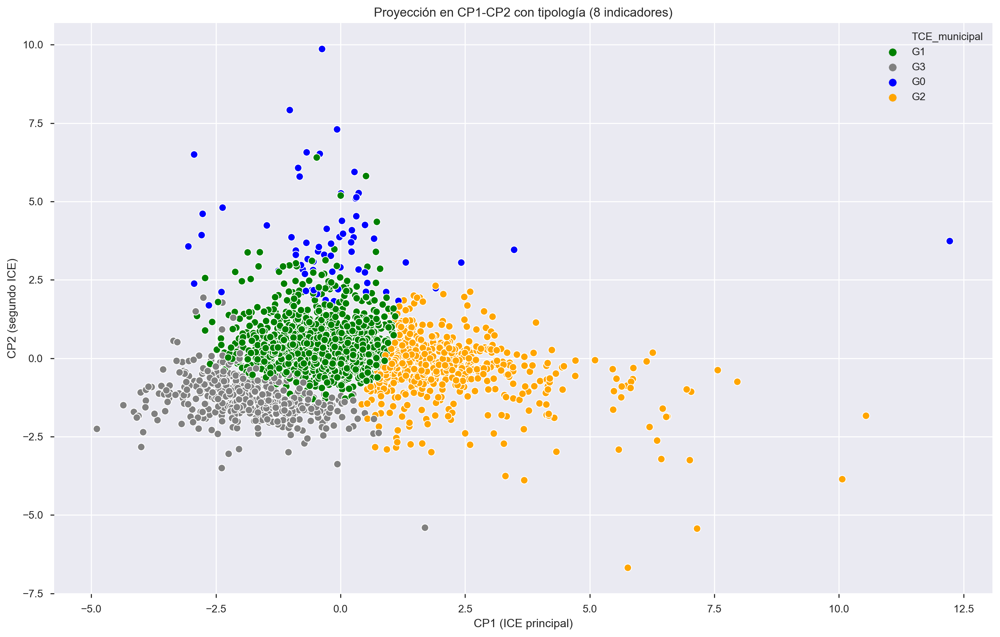

In [20]:
#Scatter plot (seaborn) PC1 vs PC2 (con clustering k-means)

plt.figure(figsize=(16, 10), dpi= 200, facecolor='w', edgecolor='k')
sns.scatterplot(x="CP1", y="CP2", 
                data=df_pca_results_ind8_kmeans, 
                hue="TCE_municipal",
                palette=color_dict)
# Set x-axis label
plt.xlabel('CP1 (ICE principal)')
# Set y-axis label
plt.ylabel('CP2 (segundo ICE)')
plt.title('Proyección en CP1-CP2 con tipología (8 indicadores)')

plt.savefig('Pyplot_PCA_Kmeans_ind8.png',dpi=600)

Gráfica en el espacio CP1, CP2, CP3

In [21]:
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.lines import Line2D

#para definir los colores
colores = df_pca_results_ind8_kmeans['TCE_municipal'].apply(lambda x: color_dict[x])

#personalizar leyenda
legend_elements = [Line2D([0], [0], marker='o', markerfacecolor='grey', color='w', label='G3'),
                   Line2D([0], [0], marker='o', markerfacecolor='orange', color='w', label='G2'),
                   Line2D([0], [0], marker='o', markerfacecolor='green', color='w', label='G1'),
                   Line2D([0], [0], marker='o', markerfacecolor='blue', color='w', label='G0')]

fig = pyplot.figure(figsize=(16, 10), dpi=600, facecolor='w', edgecolor='k')
ax = Axes3D(fig)
ax.scatter(df_pca_results_ind8_kmeans['CP1'], df_pca_results_ind8_kmeans['CP2'], df_pca_results_ind8_kmeans['CP3'], c=colores,s=15)
# ax.set_xlim3d(-10, 40)
ax.set_ylim3d(-7.5,7.5)
ax.set_zlim3d(-2,8)
ax.set_xlabel('CP1 (ICE principal)')
ax.set_ylabel('CP2 (segundo ICE)')
ax.set_zlabel('CP3 (tercer ICE)')
elev = 30.0
azim = 160.0
ax.view_init(elev, azim)
ax.legend(title='TCE_municipal', handles=legend_elements, loc='center right',fontsize='x-large')
ax.set_title('Proyección en CP1-CP2-CP3 con tipología (8 indicadores)')

plt.savefig('Pyplot_PCA_3d_Kmeans_ind8.png',dpi=600)
pyplot.show()

Gráfica 3d animada

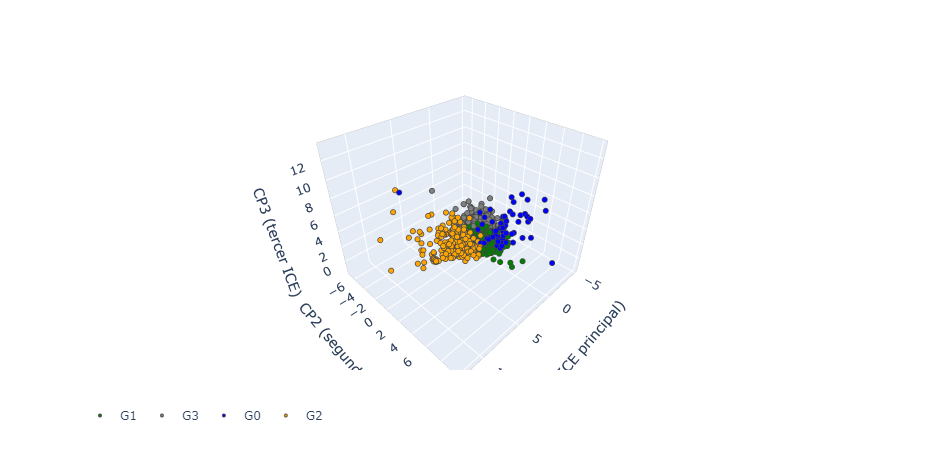

In [22]:
#3-d plot con plotly
fig = px.scatter_3d(df_pca_results_ind8_kmeans, x='CP1', y='CP2', z='CP3',
              color='TCE_municipal',
                    color_discrete_map={
                  'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey'})
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                 legend_orientation="h")
fig.show()

<br>

# Tipología de complejidad con la configuración óptima (3 clusters con 8 indicadores con transformación log)

Se utiliza la última iteración guardada de K-medias para asegurar la reproducibilidad de los resultados (recordando que K-medias es un algoritmo estocástico; y por lo tanto, en cada iteración hay variaciones en la asignación de grupos).

In [23]:
#df_pca_results_ind8_tf_kmeans = pd.read_csv("Resultados_Mun_PCA_Kmeans_ind8_tf.csv", dtype={'EDO':int,'MUN':int,'CP1':float, 'CP2':float, 'CP3':float})
df_pca_results_ind8_tf_kmeans.head()

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-1.123957,0.770085,0.164774,-0.915654,-0.492972,-0.317918,-0.188139,0.012307,G0
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.456425,-0.735941,1.007405,-0.562512,-0.936801,0.185125,-1.159336,0.032465,G1
2,1,AGUASCALIENTES,9,TEPEZALA,-2.780315,-0.217879,1.125977,-0.520060,-0.949179,-0.029845,-0.828418,0.109442,G1
3,1,AGUASCALIENTES,11,EL LLANO,-2.545177,-0.264797,0.625283,-0.108215,-0.902348,-0.148185,-0.154942,-0.011660,G1
4,1,AGUASCALIENTES,2,ASIENTOS,-2.432097,-0.075186,1.405509,0.187352,-0.990950,-0.483391,-0.528715,-0.007322,G1


Gráfica en el espacio CP1, CP2

In [24]:
#se define diccionario de colores
color_dict = dict({'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey'})

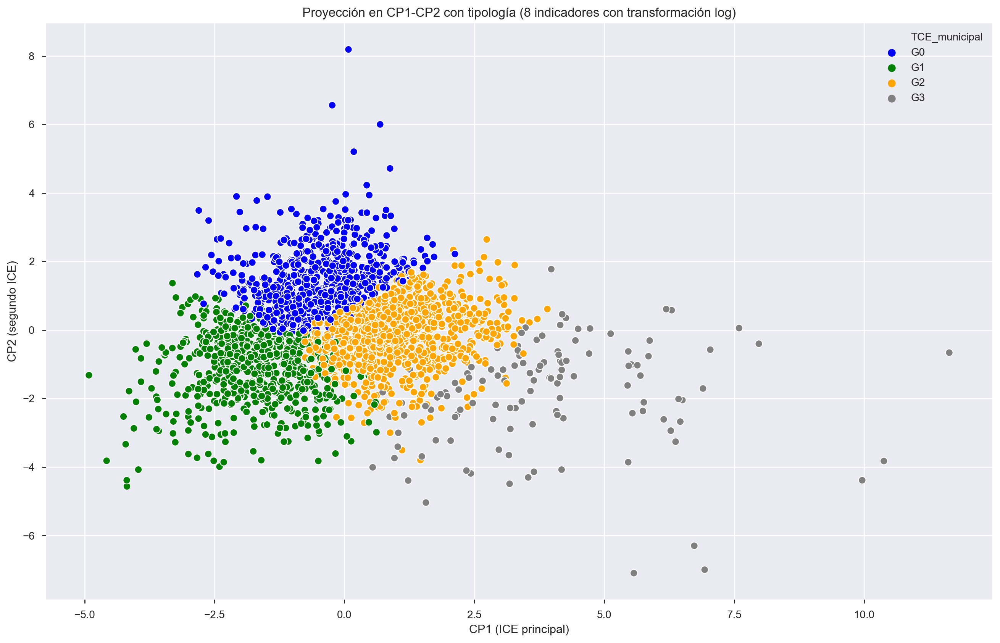

In [25]:
#Scatter plot (seaborn) PC1 vs PC2 (con clustering k-means)

plt.figure(figsize=(16, 10), dpi= 200, facecolor='w', edgecolor='k')
sns.scatterplot(x="CP1", y="CP2", 
                data=df_pca_results_ind8_tf_kmeans, 
                hue="TCE_municipal",
                palette=color_dict)
# Set x-axis label
plt.xlabel('CP1 (ICE principal)')
# Set y-axis label
plt.ylabel('CP2 (segundo ICE)')
plt.title('Proyección en CP1-CP2 con tipología (8 indicadores con transformación log)')

plt.savefig('Pyplot_PCA_Kmeans_ind8_tf.png',dpi=600)

Gráfica en el espacio CP1, CP2, CP3

In [26]:
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.lines import Line2D

#para definir los colores
colores = df_pca_results_ind8_tf_kmeans['TCE_municipal'].apply(lambda x: color_dict[x])

#personalizar leyenda
legend_elements = [Line2D([0], [0], marker='o', markerfacecolor='grey', color='w', label='G3'),
                   Line2D([0], [0], marker='o', markerfacecolor='orange', color='w', label='G2'),
                   Line2D([0], [0], marker='o', markerfacecolor='green', color='w', label='G1'),
                   Line2D([0], [0], marker='o', markerfacecolor='blue', color='w', label='G0')]

fig = pyplot.figure(figsize=(16, 10), dpi=600, facecolor='w', edgecolor='k')
ax = Axes3D(fig)
ax.scatter(df_pca_results_ind8_tf_kmeans['CP1'], df_pca_results_ind8_tf_kmeans['CP2'], df_pca_results_ind8_tf_kmeans['CP3'], c=colores,s=15)
# ax.set_xlim3d(-10, 40)
ax.set_ylim3d(-7.5,7.5)
ax.set_zlim3d(-2,8)
ax.set_xlabel('CP1 (ICE principal)')
ax.set_ylabel('CP2 (segundo ICE)')
ax.set_zlabel('CP3 (tercer ICE)')
elev = 30.0
azim = 160.0
ax.view_init(elev, azim)
ax.legend(title='TCE_municipal', handles=legend_elements, loc='center right',fontsize='x-large')
ax.set_title('Proyección en CP1-CP2-CP3 con tipología (8 indicadores con transformación log)')

plt.savefig('Pyplot_PCA_3d_Kmeans_ind8_tf.png',dpi=600)
pyplot.show()

Gráfica 3d animada

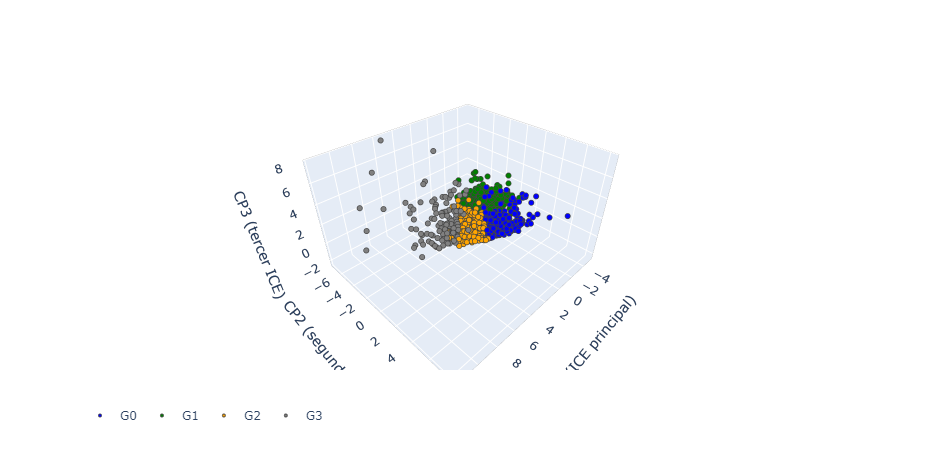

In [27]:
#3-d plot con plotly
fig = px.scatter_3d(df_pca_results_ind8_tf_kmeans, x='CP1', y='CP2', z='CP3',
              color='TCE_municipal',
                    color_discrete_map={
                  'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey'})
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                 legend_orientation="h")
fig.show()

<br>

# Análisis estadístico de los ICE y la TCE municipal (8 indicadores)

In [28]:
#unimos los resultados de PCA_Kmeans con los metadatos y los 8 indicadores de los municipios
df_indi_pca_kmeans=pd.merge(datos_mun_limpio, df_pca_results_ind8_kmeans, on=['EDO','NOMBRE_ESTADO','MUN','NOMBRE_MUNICIPIO'], how='inner')

#renombramos algunas columnas_pca
df_indi_pca_kmeans=df_indi_pca_kmeans.rename(columns={"CP1": "CP1 (ICE principal)", "CP2": "CP2 (segundo ICE)", "CP3": "CP3 (tercer ICE)"})

df_indi_pca_kmeans

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34917.0,3566.024547,0.989272,0.037498,0.015085,...,0.755939,-1.159709,-0.088926,0.085300,-0.543018,-0.142316,-0.222009,-0.187705,-0.002198,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,6914.0,2133.223463,0.991803,0.000289,0.008345,...,0.237061,-3.440113,-1.285088,0.728496,0.120293,-0.172909,-0.843930,-1.123407,0.030126,G3
2,1,AGUASCALIENTES,9,TEPEZALA,6,15545.0,2478.675412,0.990635,0.005108,0.011777,...,0.344567,-2.781418,-1.021450,0.718691,0.206965,-0.102529,-0.798143,-0.809299,0.100433,G3
3,1,AGUASCALIENTES,11,EL LLANO,6,15067.0,1505.749552,0.991016,-0.003373,0.012239,...,0.504020,-2.534965,-0.830443,0.289642,0.205096,-0.207061,-0.719092,-0.162937,-0.020207,G3
4,1,AGUASCALIENTES,2,ASIENTOS,11,34222.0,1484.722551,0.989080,0.001874,0.013432,...,0.374738,-2.431221,-0.916419,0.761197,0.793724,-0.097414,-0.731473,-0.563508,-0.024154,G3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2451,32,ZACATECAS,45,TEPECHITLAN,13,6959.0,515.205401,0.983523,0.066677,0.019408,...,0.959378,0.252723,0.103555,-0.618837,0.425519,0.394889,0.573138,-0.033045,0.063151,G1
2452,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,17372.0,1014.159112,0.986450,0.082705,0.022769,...,0.984897,0.720756,1.253073,-0.777851,1.510855,0.934339,-0.176500,-0.291345,0.040071,G1
2453,32,ZACATECAS,44,TABASCO,16,12527.0,1453.217492,0.983221,0.100307,0.029823,...,0.993335,2.179487,0.318697,-0.418799,0.704955,0.279212,-0.166946,-0.244594,-0.062764,G2
2454,32,ZACATECAS,9,CHALCHIHUITES,10,8222.0,599.837116,0.982861,0.075052,0.021097,...,0.988608,0.719159,0.007821,-0.612772,0.247552,0.252320,0.595254,-0.030123,-0.003973,G1



## Gráficas (pair-plot, box-plots, violin-plots)

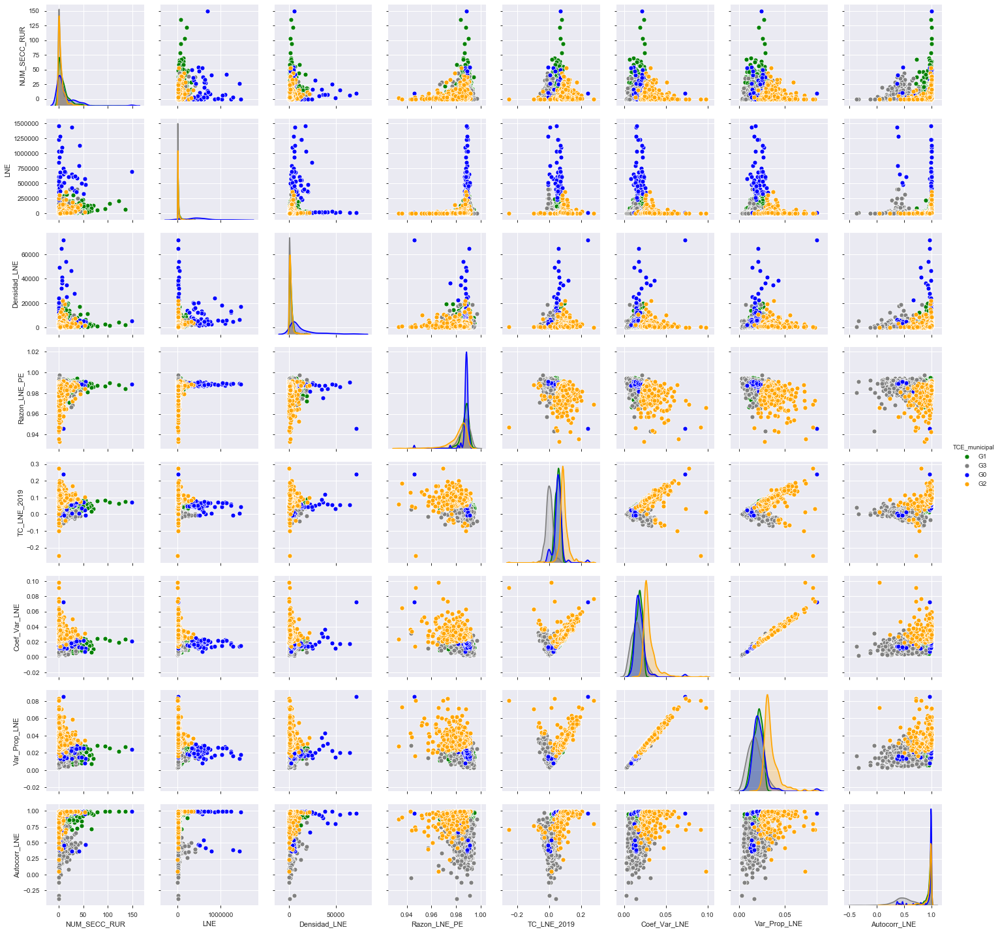

In [29]:
#sólo tomamos los indicadores y grupos
df_indi_pca_kmeans_f = df_indi_pca_kmeans[['NUM_SECC_RUR','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'TCE_municipal']]
#pair-plot (colores en funcion de grupo)
corr3=sns.pairplot(df_indi_pca_kmeans_f, 
                   hue="TCE_municipal",
                   palette=color_dict)

#guardar la pair-plot
corr3.savefig('Pyplot_correlogram_TCE_ind8.png',dpi=600)

Plotgrid de gráficas de caja para cada indicador e índice de complejidad electoral (por grupo)

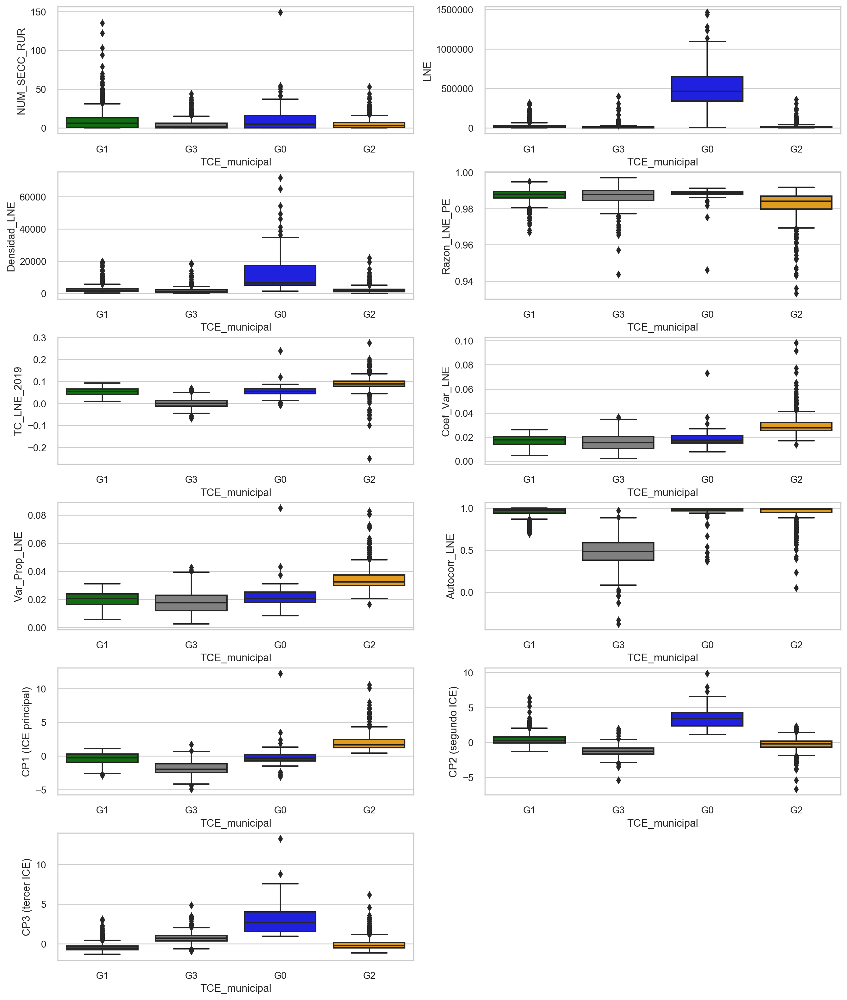

In [30]:
sns.set(style="whitegrid")
fig, axes = plt.subplots(6, 2, figsize=(16, 20), dpi= 200)

ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["LNE"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Densidad_LNE"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Var_Prop_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["CP1 (ICE principal)"], palette=color_dict, orient='v', 
    ax=axes[4, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["CP2 (segundo ICE)"], palette=color_dict, orient='v', 
    ax=axes[4, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["CP3 (tercer ICE)"], palette=color_dict, orient='v', 
    ax=axes[5, 0])

fig.delaxes(axes[5][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical
#se guarda la gráfica
plt.savefig('Pyplot_box-plots-grid_TCE_ind8.png',dpi=600)
plt.show()

Gráfica de violín (por grupos, para el indicador "Densidad_LNE")

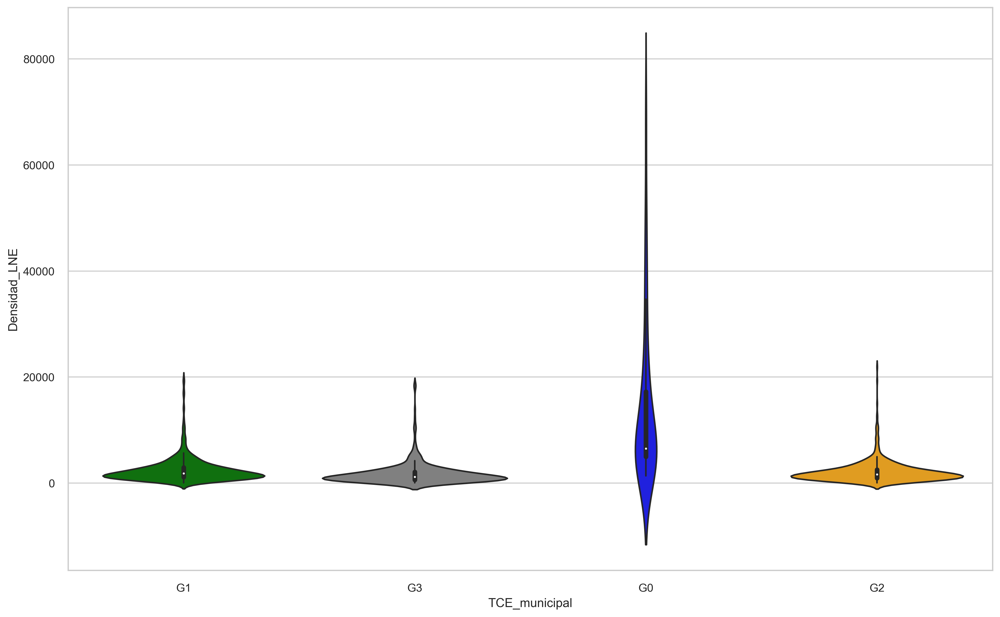

In [31]:
plt.figure(figsize=(16, 10), dpi= 300, facecolor='w', edgecolor='k')
sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Densidad_LNE"], palette=color_dict);
#se guarda la gráfica
plt.savefig('Pyplot_violin_TCE_ind8.png',dpi=600)
plt.show()

Plotgrid de gráficas de violín para cada indicador e índice de complejidad electoral (por grupo)

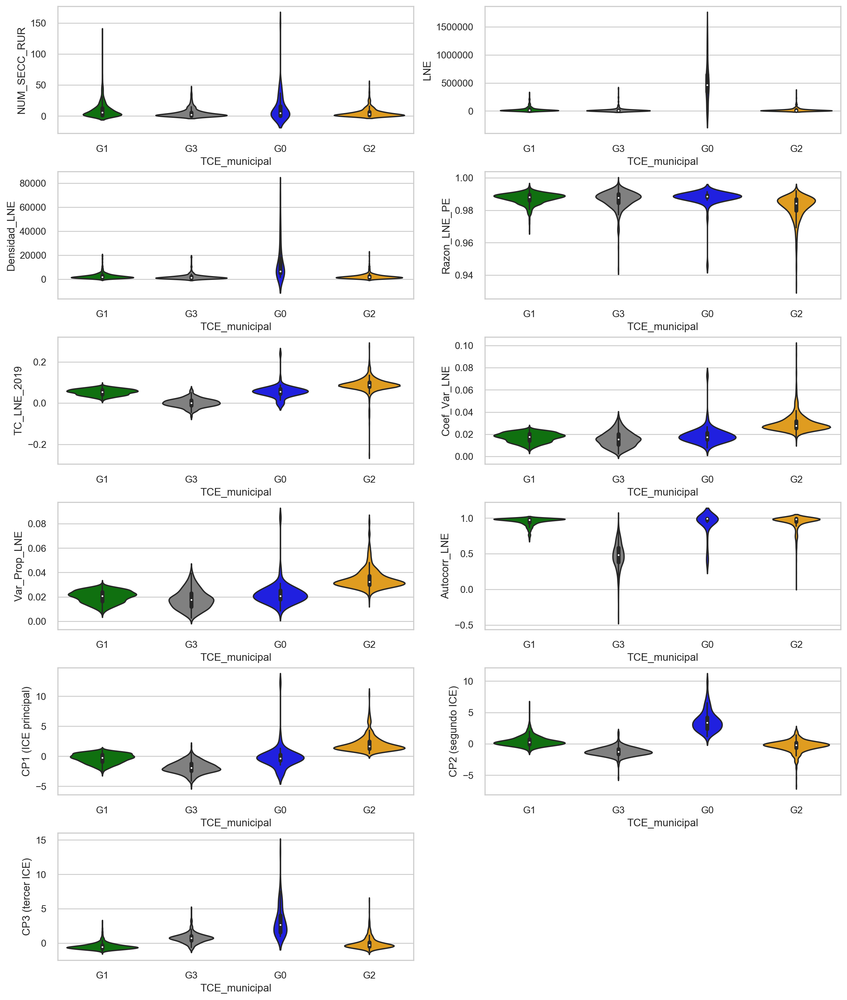

In [32]:
sns.set(style="whitegrid")

fig, axes = plt.subplots(6, 2, figsize=(16, 20), dpi= 200)
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["LNE"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Densidad_LNE"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Var_Prop_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["CP1 (ICE principal)"], palette=color_dict, orient='v', 
    ax=axes[4, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["CP2 (segundo ICE)"], palette=color_dict, orient='v', 
    ax=axes[4, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans["TCE_municipal"], y=df_indi_pca_kmeans["CP3 (tercer ICE)"], palette=color_dict, orient='v', 
    ax=axes[5, 0])

fig.delaxes(axes[5][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical

#se guarda la gráfica
plt.savefig('Pyplot_violin-plot-grid_TCE_ind8.png',dpi=600)
plt.show()


## Identificación de los valores/municipios atípicos (8 indicadores)
Etiquetamos los municipios considerados como atípicos en los ICE (considerando la separación por grupos de la tipología, y utilizando la regla intercuartil):

In [33]:
#ejemplo:
df_indi_pca_kmeans['CP1 (ICE principal)'].quantile(0.25)

-1.1246975653941826

In [34]:
def IQsR_clusters(x):
    x_0 = x['TCE_municipal'] == 'G0'
    x_g0 = x[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    return IQR_pc1_g0+IQR_pc1_g0;

In [35]:
IQsR_clusters(df_indi_pca_kmeans)

1.9558536954013719

Función para calcular el Q1, Q3 e IQR (calculado por grupos de cluster_Kmeans), y posteriormente clasificar los municipios en tipicos o atipicos en el ICE principal, en el segundo ICE, o en el tercer ICE:

In [36]:
def IQR_clusters(x):
    x_0 = df_indi_pca_kmeans['TCE_municipal'] == 'G0'
    x_g0 = df_indi_pca_kmeans[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    
    x_1 = df_indi_pca_kmeans['TCE_municipal'] == 'G1'
    x_g1 = df_indi_pca_kmeans[x_1]
    Q1_g1 = x_g1['CP1 (ICE principal)'].quantile(0.25)
    Q3_g1 = x_g1['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g1 = Q3_g1 - Q1_g1
    Q1_pc2_g1 =  x_g1['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g1 = x_g1['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g1 = Q3_pc2_g1 - Q1_pc2_g1
    Q1_pc3_g1 =  x_g1['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g1 = x_g1['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g1 = Q3_pc3_g1 - Q1_pc3_g1
    
    x_2 = df_indi_pca_kmeans['TCE_municipal'] == 'G2'
    x_g2 = df_indi_pca_kmeans[x_2]
    Q1_g2 = x_g2['CP1 (ICE principal)'].quantile(0.25)
    Q3_g2 = x_g2['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g2 = Q3_g2 - Q1_g2
    Q1_pc2_g2 =  x_g2['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g2 = x_g2['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g2 = Q3_pc2_g2 - Q1_pc2_g2
    Q1_pc3_g2 =  x_g2['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g2 = x_g2['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g2 = Q3_pc3_g2 - Q1_pc3_g2
    
    x_3 = df_indi_pca_kmeans['TCE_municipal'] == 'G3'
    x_g3 = df_indi_pca_kmeans[x_3]
    Q1_g3 = x_g3['CP1 (ICE principal)'].quantile(0.25)
    Q3_g3 = x_g3['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g3 = Q3_g3 - Q1_g3
    Q1_pc2_g3 =  x_g3['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g3 = x_g3['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g3 = Q3_pc2_g3 - Q1_pc2_g3
    Q1_pc3_g3 =  x_g3['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g3 = x_g3['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g3 = Q3_pc3_g3 - Q1_pc3_g3
    
    
    if (x['TCE_municipal'] == 'G0'):
        if (x['CP1 (ICE principal)'] < Q1_g0-1.5*IQR_pc1_g0) or (x['CP1 (ICE principal)'] > Q3_g0+1.5*IQR_pc1_g0):
            return 'Atipica en CP1'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g0-1.5*IQR_pc2_g0) or (x['CP2 (segundo ICE)'] > Q3_pc2_g0+1.5*IQR_pc2_g0):
            return 'Atipica en CP2'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g0-1.5*IQR_pc3_g0) or (x['CP3 (tercer ICE)'] > Q3_pc3_g0+1.5*IQR_pc3_g0):
            return 'Atipica en CP3'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G1'):
        if (x['CP1 (ICE principal)'] < Q1_g1-1.5*IQR_pc1_g1) or (x['CP1 (ICE principal)'] > Q3_g1+1.5*IQR_pc1_g1):
            return 'Atipica en CP1'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g1-1.5*IQR_pc2_g1) or (x['CP2 (segundo ICE)'] > Q3_pc2_g1+1.5*IQR_pc2_g1):
            return 'Atipica en CP2'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g1-1.5*IQR_pc3_g1) or (x['CP3 (tercer ICE)'] > Q3_pc3_g1+1.5*IQR_pc3_g1):
            return 'Atipica en CP3'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G2'):
        if (x['CP1 (ICE principal)'] < Q1_g2-1.5*IQR_pc1_g2) or (x['CP1 (ICE principal)'] > Q3_g2+1.5*IQR_pc1_g2):
            return 'Atipica en CP1'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g2-1.5*IQR_pc2_g2) or (x['CP2 (segundo ICE)'] > Q3_pc2_g2+1.5*IQR_pc2_g2):
            return 'Atipica en CP2'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g2-1.5*IQR_pc3_g2) or (x['CP3 (tercer ICE)'] > Q3_pc3_g2+1.5*IQR_pc3_g2):
            return 'Atipica en CP3'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G3'):
        if (x['CP1 (ICE principal)'] < Q1_g3-1.5*IQR_pc1_g3) or (x['CP1 (ICE principal)'] > Q3_g3+1.5*IQR_pc1_g3):
            return 'Atipica en CP1'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g3-1.5*IQR_pc2_g3) or (x['CP2 (segundo ICE)'] > Q3_pc2_g3+1.5*IQR_pc2_g3):
            return 'Atipica en CP2'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g3-1.5*IQR_pc3_g3) or (x['CP3 (tercer ICE)'] > Q3_pc3_g3+1.5*IQR_pc3_g3):
            return 'Atipica en CP3'
        else:
            return 'Tipica'
    else:
        return 'nan'

In [37]:
#se aplica la función al último df con los resultados:
df_indi_pca_kmeans['Atipicidad'] = df_indi_pca_kmeans.apply(IQR_clusters, axis = 1)

#se muestra el dataframe:
df_indi_pca_kmeans

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34917.0,3566.024547,0.989272,0.037498,0.015085,...,-1.159709,-0.088926,0.085300,-0.543018,-0.142316,-0.222009,-0.187705,-0.002198,G1,Tipica
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,6914.0,2133.223463,0.991803,0.000289,0.008345,...,-3.440113,-1.285088,0.728496,0.120293,-0.172909,-0.843930,-1.123407,0.030126,G3,Tipica
2,1,AGUASCALIENTES,9,TEPEZALA,6,15545.0,2478.675412,0.990635,0.005108,0.011777,...,-2.781418,-1.021450,0.718691,0.206965,-0.102529,-0.798143,-0.809299,0.100433,G3,Tipica
3,1,AGUASCALIENTES,11,EL LLANO,6,15067.0,1505.749552,0.991016,-0.003373,0.012239,...,-2.534965,-0.830443,0.289642,0.205096,-0.207061,-0.719092,-0.162937,-0.020207,G3,Tipica
4,1,AGUASCALIENTES,2,ASIENTOS,11,34222.0,1484.722551,0.989080,0.001874,0.013432,...,-2.431221,-0.916419,0.761197,0.793724,-0.097414,-0.731473,-0.563508,-0.024154,G3,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2451,32,ZACATECAS,45,TEPECHITLAN,13,6959.0,515.205401,0.983523,0.066677,0.019408,...,0.252723,0.103555,-0.618837,0.425519,0.394889,0.573138,-0.033045,0.063151,G1,Tipica
2452,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,17372.0,1014.159112,0.986450,0.082705,0.022769,...,0.720756,1.253073,-0.777851,1.510855,0.934339,-0.176500,-0.291345,0.040071,G1,Tipica
2453,32,ZACATECAS,44,TABASCO,16,12527.0,1453.217492,0.983221,0.100307,0.029823,...,2.179487,0.318697,-0.418799,0.704955,0.279212,-0.166946,-0.244594,-0.062764,G2,Tipica
2454,32,ZACATECAS,9,CHALCHIHUITES,10,8222.0,599.837116,0.982861,0.075052,0.021097,...,0.719159,0.007821,-0.612772,0.247552,0.252320,0.595254,-0.030123,-0.003973,G1,Tipica


In [38]:
#para verificar, imprimimos los valores únicos en la columna Atipicidad.
df_indi_pca_kmeans.Atipicidad.unique()

array(['Tipica', 'Atipica en CP1', 'Atipica en CP2', 'Atipica en CP3'],
      dtype=object)

In [39]:
#imprimimos la frecuencia de los valores únicos en Atipicidad
df_indi_pca_kmeans['Atipicidad'].value_counts()

Tipica            2197
Atipica en CP2     106
Atipica en CP3      98
Atipica en CP1      55
Name: Atipicidad, dtype: int64

In [40]:
#imprimimos el número de municipios por grupo de la tipología.
df_indi_pca_kmeans['TCE_municipal'].value_counts()

G1    1252
G2     649
G3     482
G0      73
Name: TCE_municipal, dtype: int64

In [41]:
#se guardan los resultados en un csv
df_indi_pca_kmeans.to_csv(r'Resultados_Mun_Indic_PCA_Kmeans_Atip_ind8.csv', index = None)

<br>

# Análisis estadístico de los ICE y la TCE municipal (8 indicadores con transformación log)

In [42]:
#unimos los resultados de PCA_Kmeans con los metadatos y los 8 indicadores de los municipios
df_indi_pca_kmeans_tf=pd.merge(datos_mun_limpio_tf, df_pca_results_ind8_tf_kmeans, on=['EDO','NOMBRE_ESTADO','MUN','NOMBRE_MUNICIPIO'], how='inner')

#renombramos algunas columnas_pca
df_indi_pca_kmeans_tf=df_indi_pca_kmeans_tf.rename(columns={"CP1": "CP1 (ICE principal)", 
                                                            "CP2": "CP2 (segundo ICE)", 
                                                            "CP3": "CP3 (tercer ICE)",
                                                           "LNE": "log(LNE)",
                                                           "Densidad_LNE": "log(Densidad_LNE)"})

df_indi_pca_kmeans_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,log(LNE),log(Densidad_LNE),Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,10.460729,8.179207,0.989272,0.037498,0.015085,...,0.755939,-1.123957,0.770085,0.164774,-0.915654,-0.492972,-0.317918,-0.188139,0.012307,G0
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,8.841304,7.665389,0.991803,0.000289,0.008345,...,0.237061,-3.456425,-0.735941,1.007405,-0.562512,-0.936801,0.185125,-1.159336,0.032465,G1
2,1,AGUASCALIENTES,9,TEPEZALA,6,9.651494,7.815480,0.990635,0.005108,0.011777,...,0.344567,-2.780315,-0.217879,1.125977,-0.520060,-0.949179,-0.029845,-0.828418,0.109442,G1
3,1,AGUASCALIENTES,11,EL LLANO,6,9.620262,7.317046,0.991016,-0.003373,0.012239,...,0.504020,-2.545177,-0.264797,0.625283,-0.108215,-0.902348,-0.148185,-0.154942,-0.011660,G1
4,1,AGUASCALIENTES,2,ASIENTOS,11,10.440624,7.302983,0.989080,0.001874,0.013432,...,0.374738,-2.432097,-0.075186,1.405509,0.187352,-0.990950,-0.483391,-0.528715,-0.007322,G1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2451,32,ZACATECAS,45,TEPECHITLAN,13,8.847791,6.244566,0.983523,0.066677,0.019408,...,0.959378,0.208244,-0.355269,-0.474706,1.141162,0.719067,-0.406781,0.034851,0.060747,G2
2452,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,9.762615,6.921815,0.986450,0.082705,0.022769,...,0.984897,0.741788,1.244269,0.149342,1.906565,0.497395,0.335199,-0.281648,0.031614,G0
2453,32,ZACATECAS,44,TABASCO,16,9.435642,7.281535,0.983221,0.100307,0.029823,...,0.993335,2.190433,0.411954,0.112989,0.742667,0.050829,0.123076,-0.241525,-0.064545,G2
2454,32,ZACATECAS,9,CHALCHIHUITES,10,9.014569,6.396658,0.982861,0.075052,0.021097,...,0.988608,0.681040,-0.336669,-0.510570,0.871445,0.621117,-0.507095,0.039586,-0.003077,G2



## Gráficas (pair-plot, box-plots, violin-plots)

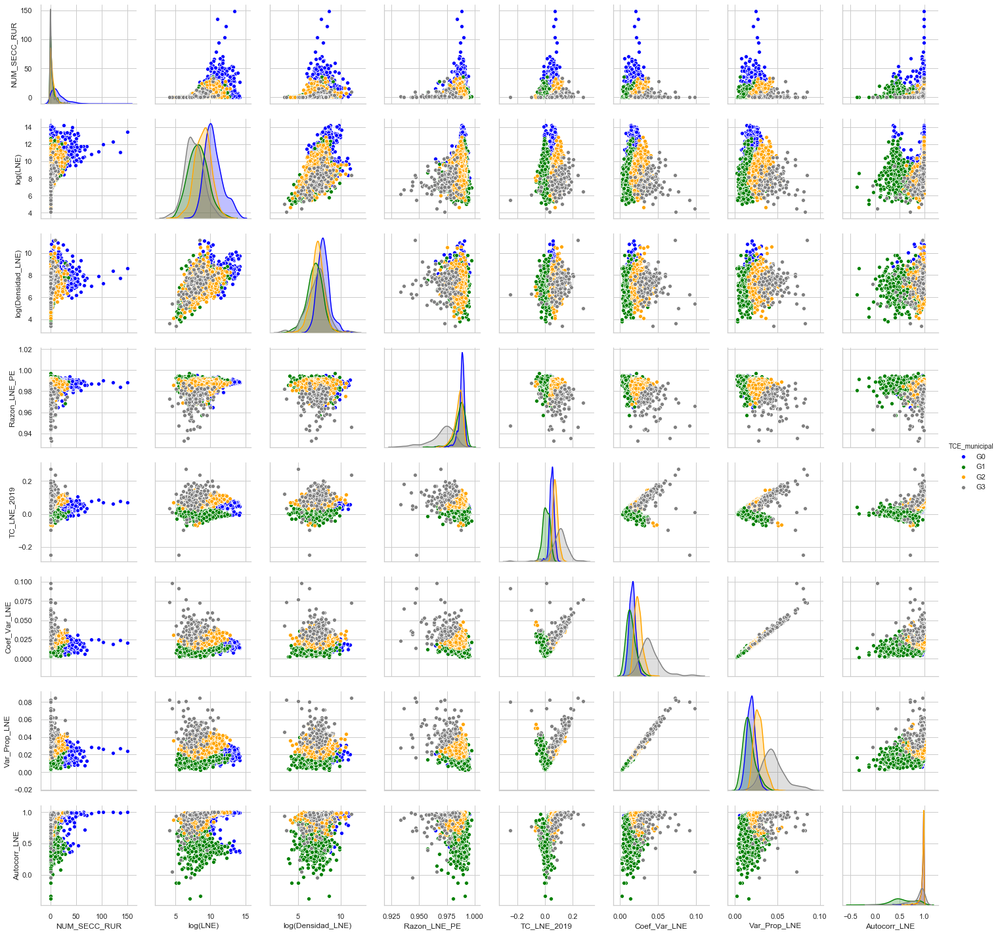

In [43]:
#sólo tomamos los indicadores y grupos
df_indi_pca_kmeans_tf_f = df_indi_pca_kmeans_tf[['NUM_SECC_RUR','log(LNE)', 'log(Densidad_LNE)', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'TCE_municipal']]
#pair-plot (colores en funcion de grupo)
corr3=sns.pairplot(df_indi_pca_kmeans_tf_f, 
                   hue="TCE_municipal",
                   palette=color_dict)

#guardar la pair-plot
corr3.savefig('Pyplot_correlogram_TCE_ind8_tf.png',dpi=600)

Plotgrid de gráficas de caja para cada indicador e índice de complejidad electoral (por grupo)

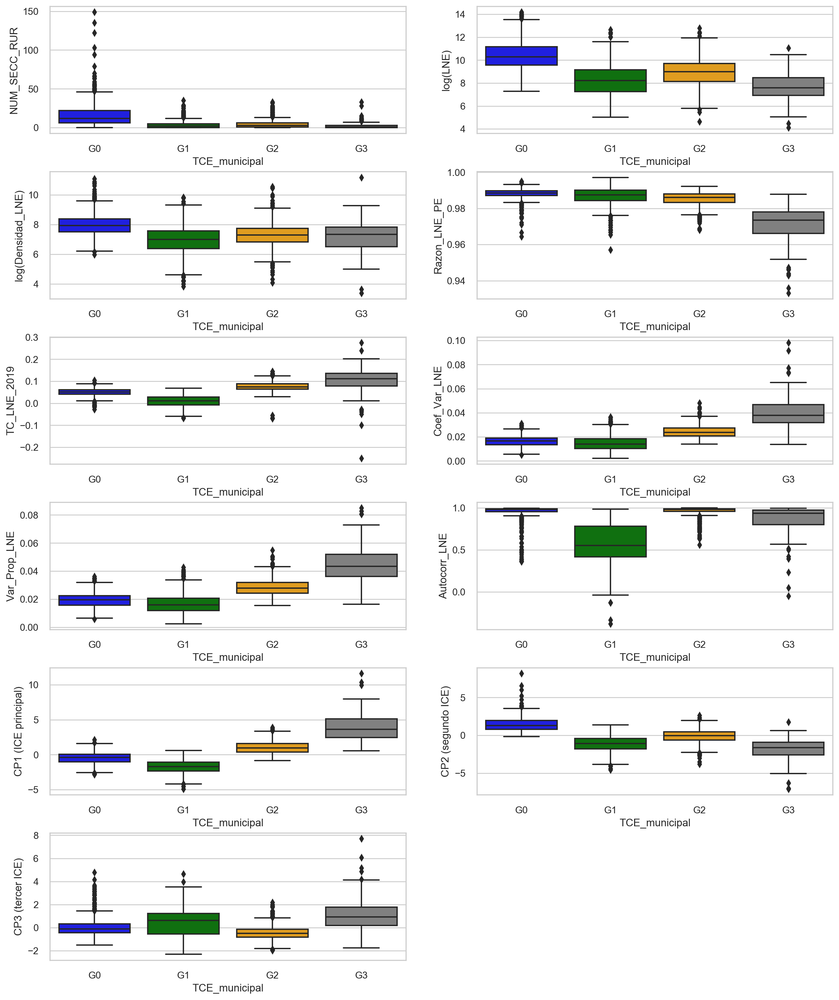

In [44]:
sns.set(style="whitegrid")
fig, axes = plt.subplots(6, 2, figsize=(16, 20), dpi= 200)

ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["log(LNE)"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["log(Densidad_LNE)"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["Var_Prop_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["CP1 (ICE principal)"], palette=color_dict, orient='v', 
    ax=axes[4, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["CP2 (segundo ICE)"], palette=color_dict, orient='v', 
    ax=axes[4, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["CP3 (tercer ICE)"], palette=color_dict, orient='v', 
    ax=axes[5, 0])

fig.delaxes(axes[5][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical
#se guarda la gráfica
plt.savefig('Pyplot_box-plots-grid_TCE_ind8_tf.png',dpi=600)
plt.show()

Gráfica de violín (por grupos, para el indicador "Densidad_LNE")

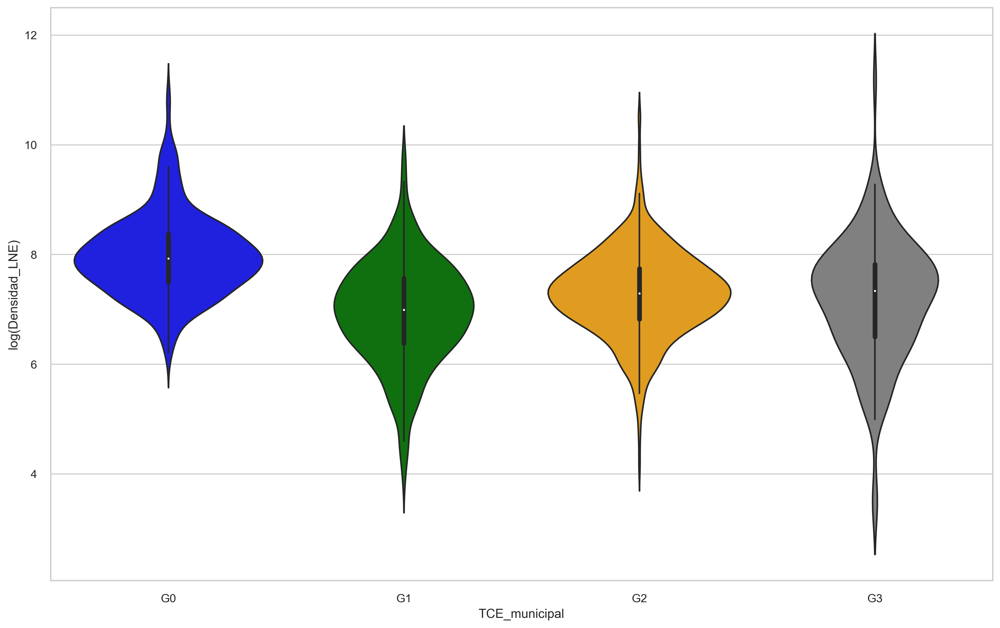

In [45]:
plt.figure(figsize=(16, 10), dpi= 300, facecolor='w', edgecolor='k')
sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["log(Densidad_LNE)"], palette=color_dict);
#se guarda la gráfica
plt.savefig('Pyplot_violin_TCE_ind8_tf.png',dpi=600)
plt.show()

Plotgrid de gráficas de violín para cada indicador e índice de complejidad electoral (por grupo)

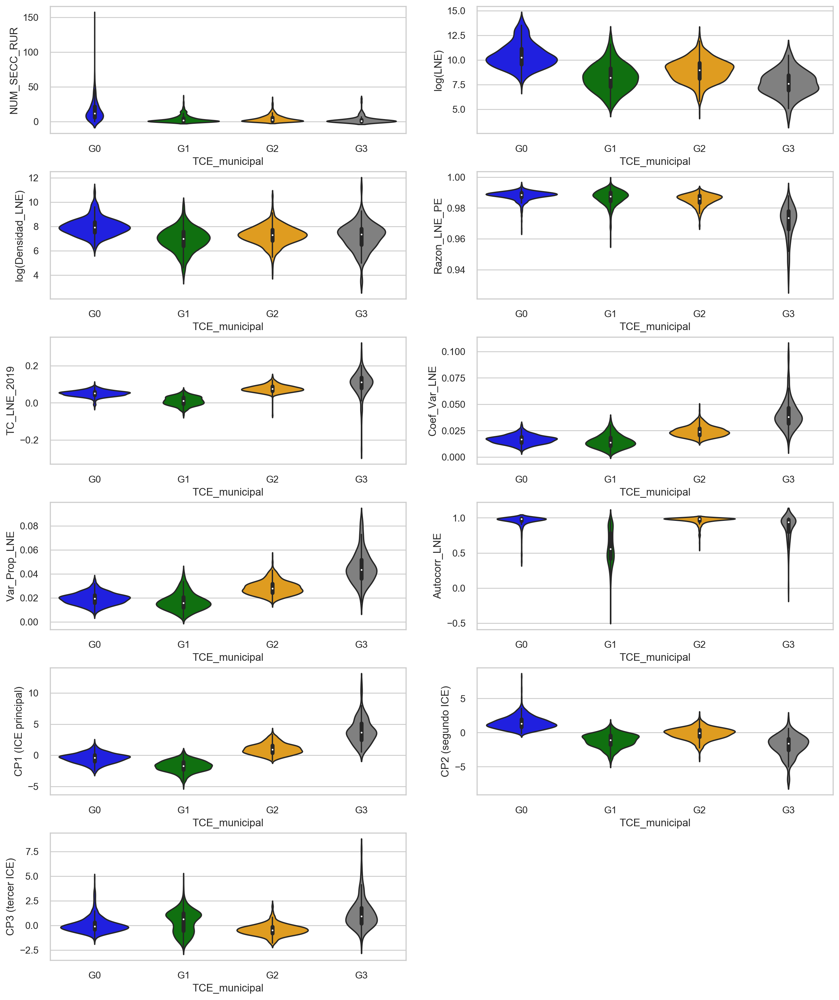

In [46]:
sns.set(style="whitegrid")

fig, axes = plt.subplots(6, 2, figsize=(16, 20), dpi= 200)
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["log(LNE)"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["log(Densidad_LNE)"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["Var_Prop_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["CP1 (ICE principal)"], palette=color_dict, orient='v', 
    ax=axes[4, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["CP2 (segundo ICE)"], palette=color_dict, orient='v', 
    ax=axes[4, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_tf["TCE_municipal"], y=df_indi_pca_kmeans_tf["CP3 (tercer ICE)"], palette=color_dict, orient='v', 
    ax=axes[5, 0])

fig.delaxes(axes[5][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical

#se guarda la gráfica
plt.savefig('Pyplot_violin-plot-grid_TCE_ind8_tf.png',dpi=600)
plt.show()


## Identificación de los valores/municipios atípicos (8 indicadores con transformación log)
Etiquetamos los municipios considerados como atípicos en los ICE (considerando la separación por grupos de la tipología, y utilizando la regla intercuartil):

In [47]:
#ejemplo:
df_indi_pca_kmeans_tf['CP1 (ICE principal)'].quantile(0.25)

-1.1346531575920131

In [48]:
def IQsR_clusters(x):
    x_0 = x['TCE_municipal'] == 'G0'
    x_g0 = x[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    return IQR_pc1_g0+IQR_pc1_g0;

In [49]:
IQsR_clusters(df_indi_pca_kmeans_tf)

2.1054923994043158

Función para calcular el Q1, Q3 e IQR (calculado por grupos de cluster_Kmeans), y posteriormente clasificar los municipios en tipicos o atipicos en el ICE principal, en el segundo ICE, o en el tercer ICE:

In [50]:
def IQR_clusters_tf(x):
    x_0 = df_indi_pca_kmeans_tf['TCE_municipal'] == 'G0'
    x_g0 = df_indi_pca_kmeans_tf[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    
    x_1 = df_indi_pca_kmeans_tf['TCE_municipal'] == 'G1'
    x_g1 = df_indi_pca_kmeans_tf[x_1]
    Q1_g1 = x_g1['CP1 (ICE principal)'].quantile(0.25)
    Q3_g1 = x_g1['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g1 = Q3_g1 - Q1_g1
    Q1_pc2_g1 =  x_g1['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g1 = x_g1['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g1 = Q3_pc2_g1 - Q1_pc2_g1
    Q1_pc3_g1 =  x_g1['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g1 = x_g1['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g1 = Q3_pc3_g1 - Q1_pc3_g1
    
    x_2 = df_indi_pca_kmeans_tf['TCE_municipal'] == 'G2'
    x_g2 = df_indi_pca_kmeans_tf[x_2]
    Q1_g2 = x_g2['CP1 (ICE principal)'].quantile(0.25)
    Q3_g2 = x_g2['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g2 = Q3_g2 - Q1_g2
    Q1_pc2_g2 =  x_g2['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g2 = x_g2['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g2 = Q3_pc2_g2 - Q1_pc2_g2
    Q1_pc3_g2 =  x_g2['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g2 = x_g2['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g2 = Q3_pc3_g2 - Q1_pc3_g2
    
    x_3 = df_indi_pca_kmeans_tf['TCE_municipal'] == 'G3'
    x_g3 = df_indi_pca_kmeans_tf[x_3]
    Q1_g3 = x_g3['CP1 (ICE principal)'].quantile(0.25)
    Q3_g3 = x_g3['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g3 = Q3_g3 - Q1_g3
    Q1_pc2_g3 =  x_g3['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g3 = x_g3['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g3 = Q3_pc2_g3 - Q1_pc2_g3
    Q1_pc3_g3 =  x_g3['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g3 = x_g3['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g3 = Q3_pc3_g3 - Q1_pc3_g3
    
    
    if (x['TCE_municipal'] == 'G0'):
        if (x['CP1 (ICE principal)'] < Q1_g0-1.5*IQR_pc1_g0) or (x['CP1 (ICE principal)'] > Q3_g0+1.5*IQR_pc1_g0):
            return 'Atipica en CP1'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g0-1.5*IQR_pc2_g0) or (x['CP2 (segundo ICE)'] > Q3_pc2_g0+1.5*IQR_pc2_g0):
            return 'Atipica en CP2'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g0-1.5*IQR_pc3_g0) or (x['CP3 (tercer ICE)'] > Q3_pc3_g0+1.5*IQR_pc3_g0):
            return 'Atipica en CP3'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G1'):
        if (x['CP1 (ICE principal)'] < Q1_g1-1.5*IQR_pc1_g1) or (x['CP1 (ICE principal)'] > Q3_g1+1.5*IQR_pc1_g1):
            return 'Atipica en CP1'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g1-1.5*IQR_pc2_g1) or (x['CP2 (segundo ICE)'] > Q3_pc2_g1+1.5*IQR_pc2_g1):
            return 'Atipica en CP2'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g1-1.5*IQR_pc3_g1) or (x['CP3 (tercer ICE)'] > Q3_pc3_g1+1.5*IQR_pc3_g1):
            return 'Atipica en CP3'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G2'):
        if (x['CP1 (ICE principal)'] < Q1_g2-1.5*IQR_pc1_g2) or (x['CP1 (ICE principal)'] > Q3_g2+1.5*IQR_pc1_g2):
            return 'Atipica en CP1'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g2-1.5*IQR_pc2_g2) or (x['CP2 (segundo ICE)'] > Q3_pc2_g2+1.5*IQR_pc2_g2):
            return 'Atipica en CP2'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g2-1.5*IQR_pc3_g2) or (x['CP3 (tercer ICE)'] > Q3_pc3_g2+1.5*IQR_pc3_g2):
            return 'Atipica en CP3'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G3'):
        if (x['CP1 (ICE principal)'] < Q1_g3-1.5*IQR_pc1_g3) or (x['CP1 (ICE principal)'] > Q3_g3+1.5*IQR_pc1_g3):
            return 'Atipica en CP1'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g3-1.5*IQR_pc2_g3) or (x['CP2 (segundo ICE)'] > Q3_pc2_g3+1.5*IQR_pc2_g3):
            return 'Atipica en CP2'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g3-1.5*IQR_pc3_g3) or (x['CP3 (tercer ICE)'] > Q3_pc3_g3+1.5*IQR_pc3_g3):
            return 'Atipica en CP3'
        else:
            return 'Tipica'
    else:
        return 'nan'

In [51]:
#se aplica la función al último df con los resultados:
df_indi_pca_kmeans_tf['Atipicidad'] = df_indi_pca_kmeans_tf.apply(IQR_clusters_tf, axis = 1)

#se muestra el dataframe:
df_indi_pca_kmeans_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,log(LNE),log(Densidad_LNE),Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,10.460729,8.179207,0.989272,0.037498,0.015085,...,-1.123957,0.770085,0.164774,-0.915654,-0.492972,-0.317918,-0.188139,0.012307,G0,Tipica
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,8.841304,7.665389,0.991803,0.000289,0.008345,...,-3.456425,-0.735941,1.007405,-0.562512,-0.936801,0.185125,-1.159336,0.032465,G1,Tipica
2,1,AGUASCALIENTES,9,TEPEZALA,6,9.651494,7.815480,0.990635,0.005108,0.011777,...,-2.780315,-0.217879,1.125977,-0.520060,-0.949179,-0.029845,-0.828418,0.109442,G1,Tipica
3,1,AGUASCALIENTES,11,EL LLANO,6,9.620262,7.317046,0.991016,-0.003373,0.012239,...,-2.545177,-0.264797,0.625283,-0.108215,-0.902348,-0.148185,-0.154942,-0.011660,G1,Tipica
4,1,AGUASCALIENTES,2,ASIENTOS,11,10.440624,7.302983,0.989080,0.001874,0.013432,...,-2.432097,-0.075186,1.405509,0.187352,-0.990950,-0.483391,-0.528715,-0.007322,G1,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2451,32,ZACATECAS,45,TEPECHITLAN,13,8.847791,6.244566,0.983523,0.066677,0.019408,...,0.208244,-0.355269,-0.474706,1.141162,0.719067,-0.406781,0.034851,0.060747,G2,Tipica
2452,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,9.762615,6.921815,0.986450,0.082705,0.022769,...,0.741788,1.244269,0.149342,1.906565,0.497395,0.335199,-0.281648,0.031614,G0,Tipica
2453,32,ZACATECAS,44,TABASCO,16,9.435642,7.281535,0.983221,0.100307,0.029823,...,2.190433,0.411954,0.112989,0.742667,0.050829,0.123076,-0.241525,-0.064545,G2,Tipica
2454,32,ZACATECAS,9,CHALCHIHUITES,10,9.014569,6.396658,0.982861,0.075052,0.021097,...,0.681040,-0.336669,-0.510570,0.871445,0.621117,-0.507095,0.039586,-0.003077,G2,Tipica


In [52]:
#para verificar, imprimimos los valores únicos en la columna Atipicidad.
df_indi_pca_kmeans_tf.Atipicidad.unique()

array(['Tipica', 'Atipica en CP1', 'Atipica en CP3', 'Atipica en CP2'],
      dtype=object)

In [53]:
#imprimimos la frecuencia de los valores únicos en Atipicidad
df_indi_pca_kmeans_tf['Atipicidad'].value_counts()

Tipica            2340
Atipica en CP3      60
Atipica en CP2      35
Atipica en CP1      21
Name: Atipicidad, dtype: int64

In [54]:
#imprimimos el número de municipios por grupo de la tipología.
df_indi_pca_kmeans_tf['TCE_municipal'].value_counts()

G2    957
G0    745
G1    633
G3    121
Name: TCE_municipal, dtype: int64

In [55]:
#se guardan los resultados en un csv
df_indi_pca_kmeans_tf.to_csv(r'Resultados_Mun_Indic_PCA_Kmeans_Atip_ind8_tf.csv', index = None)

<br>

## Referencias
- https://www.analyticsvidhya.com/blog/2018/08/dimensionality-reduction-techniques-python/
- https://plot.ly/python/v3/ipython-notebooks/principal-component-analysis/#pca-vs-lda
- https://www.machinelearningplus.com/plots/top-50-matplotlib-visualizations-the-master-plots-python
- https://towardsdatascience.com/visualising-high-dimensional-datasets-using-pca-and-t-sne-in-python-8ef87e7915b
- https://alexanderfabisch.github.io/t-sne-in-scikit-learn.html
- https://medium.com/@indreshbhattacharyya/feature-selection-categorical-feature-selection-boruta-light-gbm-chi-square-bf47e94e2558
- https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html
- https://stackoverflow.com/questions/52472757/creating-a-boxplot-facetgrid-in-seaborn-for-python
- https://www.kdnuggets.com/2019/07/10-simple-hacks-speed-data-analysis-python.html
- https://github.com/adam-p/markdown-here/wiki/Markdown-Here-Cheatsheet